# Import Drive and Libraries and Load Data

In [347]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [348]:
# Load the TensorBoard notebook extension.

%reload_ext tensorboard
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dense
from tensorflow.keras import initializers
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.optimizers import SGD
from tensorflow.python.keras.optimizer_v2.adam import Adam
from tensorflow.keras.layers import Dropout
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from tensorflow.keras import backend as K
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
import pandas as pd
import numpy as np
import pathlib
import pickle
import pathlib
import matplotlib.pyplot as plt
from matplotlib.pyplot import cm
from datetime import datetime
import seaborn as sns
import tensorboard
import os
tensorboard.__version__

'2.7.0'

In [349]:
# Load Data from Google Drive Shared Drive (Microclimate-Building Energy)
Data = pd.read_csv('/content/drive/Shareddrives/Microclimate-Building Energy/Data/microclimate_model/Combined/summer_limited2.csv')
Data = Data.drop(columns = ['Unnamed: 0'])

In [350]:
Data

,bldgname,Date_Time,Month,Day,Hour,Minute,Air Temp,Abs Hum,Rel Hum,DSW Top,DSW North,DSW East,DSW South,DSW West,Shade North,Shade East,Shade South,Shade West,KW,CHWTON/SQFT,CHWTON,HTmmBTU
0,Noble Library,2018-05-10 05:00:00,5,10,5,0,25.703975,4.623121,19.291395,0.000000,0.00000,0.000000,0.0,0.0,1.00000,1.000000,1.0,1.0,151.45,0.000819,72.65,-0.01
1,Noble Library,2018-05-10 05:15:00,5,10,5,15,24.823049,5.473015,23.995860,0.000000,0.00000,0.000000,0.0,0.0,1.00000,1.000000,1.0,1.0,148.77,0.000843,74.71,-0.01
2,Noble Library,2018-05-10 05:30:00,5,10,5,30,24.592168,5.313983,23.603941,0.000000,0.00000,0.000000,0.0,0.0,1.00000,1.000000,1.0,1.0,151.19,0.000804,71.30,-0.01
3,Noble Library,2018-05-10 05:45:00,5,10,5,45,24.470944,5.281298,23.619905,0.000000,0.00000,0.000000,0.0,0.0,1.00000,1.000000,1.0,1.0,150.77,0.000817,72.39,-0.01
4,Noble Library,2018-05-10 06:00:00,5,10,6,0,24.303326,5.233725,23.630016,6.212184,7.77669,3.178121,0.0,0.0,0.87432,0.983183,1.0,1.0,147.82,0.000830,73.55,-0.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9744,Biodesign B,2018-08-03 19:45:00,8,3,19,45,40.093379,10.260438,19.985384,0.000000,0.00000,0.000000,0.0,0.0,1.00000,1.000000,1.0,1.0,533.46,0.006649,879.16,0.48
9745,Biodesign B,2018-08-03 20:00:00,8,3,20,0,39.979194,10.318371,20.213554,0.000000,0.00000,0.000000,0.0,0.0,1.00000,1.000000,1.0,1.0,529.17,0.006662,880.77,0.47
9746,Biodesign B,2018-08-03 20:15:00,8,3,20,15,39.832983,10.369758,20.463749,0.000000,0.00000,0.000000,0.0,0.0,1.00000,1.000000,1.0,1.0,518.22,0.006469,855.33,0.47
9747,Biodesign B,2018-08-03 20:30:00,8,3,20,30,39.727691,10.444581,20.720654,0.000000,0.00000,0.000000,0.0,0.0,1.00000,1.000000,1.0,1.0,519.32,0.006594,871.77,0.47


# *Functions Used in Notebook*

In [351]:
# USE TO RETRUN ONE-HOT-ENCODED DATA TO ORIGINAL COLUMNS
def undummify(df, prefix_sep="_"):
    cols2collapse = {
        item.split(prefix_sep)[0]: (prefix_sep in item) for item in df.columns
    }
    series_list = []
    for col, needs_to_collapse in cols2collapse.items():
        if needs_to_collapse:
            undummified = (
                df.filter(like=col)
                .idxmax(axis=1)
                .apply(lambda x: x.split(prefix_sep, maxsplit=1)[1])
                .rename(col)
            )
            series_list.append(undummified)
        else:
            series_list.append(df[col])
    undummified_df = pd.concat(series_list, axis=1)
    return undummified_df

# PCA Transformation
def pca_conversion(df, columns, PCA_instance):
  df = df[columns]
  PCA = PCA_instance.fit_transform(df)
  return PCA

# USE TO SELECT DIFFERENT MODEL FEATURES
def data_features(scenario, add_artificial):
  og_cols = ['bldgname','Hour', 'Air Temp','Abs Hum','Air Temp Squared','Abs Hum Squared','Air Temp x Abs Hum',
            'DSW Top','DSW North','DSW South','DSW East','DSW West','Shade North','Shade East','Shade West','Shade South']
  if add_artificial == True:
    if scenario == 'With All':
      cols = og_cols.copy()
    elif scenario == 'Without DSW':
      cols = og_cols[0:7] + og_cols[12:]  
    elif scenario == 'Without Shade':
      cols = og_cols[0:12] 
    elif scenario == 'Without DSW and Shade':
      cols = og_cols[0:7]
    elif scenario == 'With PCA Shade':
      cols = og_cols[0:7] + ['Shade PCA']
    elif scenario == 'With PCA DSW':
      cols = og_cols[0:7] + ['DSW PCA']
    elif scenario == 'With PCA Shade and DSW':
      cols = og_cols[0:7] + ['Shade PCA', 'DSW PCA'] 
  elif add_artificial == False:
    if scenario == 'With All':
      cols = og_cols[0:4] + og_cols[7:-2]
    elif scenario == 'Without DSW':
      cols = og_cols[0:4] + og_cols[12:]
    elif scenario == 'Without Shade':
      cols = og_cols[0:4] + og_cols[7:12]
    elif scenario == 'Without DSW and Shade':
      cols = og_cols[0:4]
    elif scenario == 'With PCA Shade':
      cols = og_cols[0:4] + ['Shade PCA']
    elif scenario == 'With PCA DSW':
      cols = og_cols[0:4] + ['DSW PCA']
    elif scenario == 'With PCA Shade and DSW':
      cols = og_cols[0:4] + ['Shade PCA', 'DSW PCA']
  scols = cols.copy()
  scols.remove('bldgname')      
  return cols, scols 


# USE TO ADD TIME SHIFTED DATA FOR COLS (T-(timestep)) AND REORDERS DATA COLUMNS
def time_shift(df, timestep, cols):
  if timestep > 0:
    cols_ = ['shifted_' + str(timestep) + '_' + col for col in cols]
    df[cols_] = df[cols]
    df[cols_] = df[cols_].shift(periods=timestep*-1)
    df = df[['bldgname', 'Date_Time', 'Month', 'Day'] + cols + cols_ + ['CHWTON/SQFT']]
  elif timestep == 0:
    df = df[['bldgname', 'Date_Time', 'Month', 'Day'] + cols + ['CHWTON/SQFT']]
    cols_ = []
  return df, cols_
  
# USE TO ADD ARTIFICIAL FEATURES AND APPLY AIR TEMPERATURE AND ABS HUM REDUCTIONS
def df_airT_absH(df, airtempred, abshumred):
  """
  :df: dataframe to modify
  :airtempred: air temperature reductions in C (enter positive value)
  :abshumred: absolute humidity reduction (enter positive value)
  :return: dataframe after modifications
  """ 
  df['Air Temp'] = df['Air Temp'] - airtempred
  df['Abs Hum'] = df['Abs Hum'] - abshumred
  df['Air Temp Squared'] = df['Air Temp']**2
  df['Abs Hum Squared'] = df['Abs Hum']**2
  df['Air Temp x Abs Hum'] = df['Air Temp']*df['Abs Hum']
  return df 

# CHANGE SHADE ON FACADES OF DATA
def change_shade(df, shadered, facades):
  """
  :df: dataframe to change shade for
  :shadred: amount of shade to reduce (0 - 1)
  :facades: facades in df columns, enter 'All' for all facades
  :return: df with shade modifications
  """ 
  df = Data.copy()
  if facades == 'All':
      facade = ['Shade West', 'Shade East', 'Shade North', 'Shade South']
      for f in facade:
        df.loc[df[f] + df[f]*shadered > 1, f] = 1
        df.loc[df[f] + df[f]*shadered < 1, f] = df[f] + df[f]*shadered
  else:
    for f, F in enumerate(facades):
      df.loc[df[F] + df[F]*shadered[f] > 1, F] = 1
      df.loc[df[F] + df[F]*shadered[f] < 1, F] = df[F] + df[F]*shadered[f]
  return df

# USE TO RUN BASE MODEL AFTER SELECTING FEATURES
def base_model(epochs, batch_size, dropout, validation_split, test_size): 
  """
  :epoch: number of epochs to run
  :batch_size: batch size
  :dropout: dropout value
  :return: results and model
  """ 
  model = Sequential()
  model.add(Dense(100, input_dim = len(X.columns), activation='relu'))
  model.add(Dense(200, activation='relu'))
  model.add(Dropout(dropout))
  model.add(Dense(100, activation='relu'))
  model.add(Dropout(dropout))
  model.add(Dense(100, activation='relu'))
  model.add(Dropout(dropout))
  model.add(Dense(1, activation = 'linear'))
  model.compile( loss = 'mse', optimizer = 'adam', metrics=[tf.keras.metrics.MeanSquaredError()])
  epochs = epochs
  batch_size = batch_size
  validation_split = validation_split
  history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, validation_split=validation_split)
  y_preds = model.predict(X_test)
  RMSE = np.sqrt(metrics.mean_squared_error(y_test, y_preds))
  R2_score = metrics.r2_score(y_test, y_preds)
  results = pd.DataFrame({'R2 Score': [R2_score], 'RMSE':[RMSE]})
  results['Epoch'] = epoch
  results['Dropout'] = dropout
  results['Validation_Split'] = validation_split
  results['Test Data'] = test_size
  return results, model, history

def plot_loss_accuracy(history):
    fig = plt.figure(figsize=(20, 6))
    ax = fig.add_subplot(1, 2, 1)
    ax.plot(history.history["loss"],'r-x', label="Train Loss")
    ax.plot(history.history["val_loss"],'b-x', label="Validation Loss")
    ax.legend()
    ax.set_title('MSE Loss')
    ax.grid(True)

# Multicollinearity and PCA

A simple method to detect multicollinearity in a model is by using something called the variance inflation factor or the VIF for each predicting variable. An acceptable VIF is if it’s less than the max of 10



In [352]:
from statsmodels.stats.outliers_influence import variance_inflation_factor 

ShadeData = Data.copy()
DSWData = Data.copy()

shade_cols = ['Shade North','Shade East','Shade West','Shade South']
DSW_cols = ['DSW Top', 'DSW North', 'DSW East', 'DSW South','DSW West']

# Shade Data
shade_vif = pd.DataFrame()
shade_vif["feature"] = ShadeData[shade_cols].columns
shade_vif["VIF"] = [variance_inflation_factor(ShadeData[shade_cols].values, i) for i in range(len(ShadeData[shade_cols].columns))]

display(shade_vif)

# Shade Data
DSW_vif = pd.DataFrame()
DSW_vif["feature"] = DSWData[DSW_cols].columns
DSW_vif["VIF"] = [variance_inflation_factor(DSWData[DSW_cols].values, i) for i in range(len(DSWData[DSW_cols].columns))]

display(DSW_vif)

,feature,VIF
0,Shade North,15.961722
1,Shade East,12.619308
2,Shade West,13.928738
3,Shade South,10.787818


,feature,VIF
0,DSW Top,13.671928
1,DSW North,1.562694
2,DSW East,3.284111
3,DSW South,7.252325
4,DSW West,2.991002


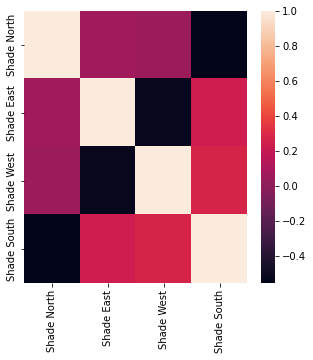

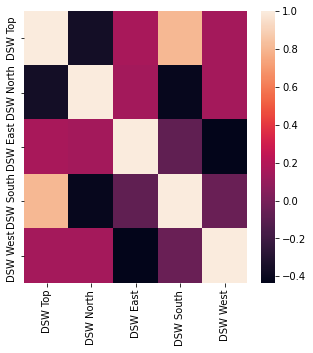

In [353]:
corrMatrix = ShadeData[shade_cols].corr()
plt.figure(figsize=(5,5))
sns.heatmap(corrMatrix)
plt.show()

corrMatrix = DSWData[DSW_cols].corr()
plt.figure(figsize=(5,5))
sns.heatmap(corrMatrix)
plt.show()

In [354]:
## Add One Column for Shade and Once for DSW using PCA
PCA_Shade_instance = PCA(n_components = 1)
PCA_DSW_instance = PCA(n_components = 1)

Data['Shade PCA'] = pca_conversion(ShadeData, shade_cols, PCA_Shade_instance)
Data['DSW PCA'] = pca_conversion(DSWData, DSW_cols, PCA_DSW_instance)

# ***Baseline Model***

## *Define* Base NN Model

In [355]:
## Select data scenario
scenarios = ['With All', 'Without DSW', 'Without Shade', 'Without DSW and Shade', 'With PCA Shade', 'With PCA DSW', 'With PCA Shade and DSW'] 
print('[1] WITH ALL -- [2] WITHOUT DSW -- [3] WITHOUT SHADE -- [4] WITHOUT DSW AND SHADE -- [5] WITH PCA SHADE -- [6] WITH PCA DSW -- [7] WITH PCA SHADE & DSW')


# Choose to add artificial features 
feat_type = int(input('Enter Value: '))
print('You selected: ', scenarios[feat_type - 1])
print('[1] ADD artificial features -- [2] DO NOT ADD arificial features')
feat_arti = int(input('Enter Value: '))
if feat_arti == 1:
  artif = True
  print('Added Artificial Features')
else: 
  artif = False
  print('No Artificial Features Added')

# Enter timestep to shift data
shift_ = int(input('Timestemps to shift df: '))

# Assign columns using data_features function
cols, scols = data_features(scenarios[feat_type - 1], artif)

[1] WITH ALL -- [2] WITHOUT DSW -- [3] WITHOUT SHADE -- [4] WITHOUT DSW AND SHADE -- [5] WITH PCA SHADE -- [6] WITH PCA DSW -- [7] WITH PCA SHADE & DSW
Enter Value: 3
You selected:  Without Shade
[1] ADD artificial features -- [2] DO NOT ADD arificial features
Enter Value: 1
Added Artificial Features
Timestemps to shift df: 1


In [356]:
# Scalers
xscaler = StandardScaler()
yscaler = StandardScaler()

# Scale Original Data Based on Selected Features
Data_Scaled = Data.copy()
Data_Scaled = df_airT_absH(Data_Scaled, 0, 0)
Data_Scaled[scols] = xscaler.fit_transform(Data_Scaled[scols])

# Perform Data Shift for each building and dropna
buildings = Data_Scaled['bldgname'].unique()
bldg_list = []

# Get unique months in dataset
unique_m = Data_Scaled['Month'].unique()

# Loop Over Every Day in Data
for m,M in enumerate(unique_m):
  unique_d = Data_Scaled[Data_Scaled['Month'] == M]['Day'].unique()
  for d,D in enumerate(unique_d):
    for b,B in enumerate(buildings):
      bldg_df = Data_Scaled[Data_Scaled['bldgname']== B].copy()
      month = bldg_df.loc[bldg_df['Month'] == M]
      day = month.loc[month['Day'] == D]
      day = df_airT_absH(day, 0,0)
      day, cols_ = time_shift(day, shift_, scols)
      day = day.dropna()
      bldg_list.append(day)
bldgs_df = bldg_list[0]
for i in range(len(bldg_list)-1):
  bldgs_df = bldgs_df.append(bldg_list[i+1])

# Assign Y 
Y = bldgs_df['CHWTON/SQFT']
Y = Y.values.reshape(-1, 1)
Y = yscaler.fit_transform(Y)

# Use to rearrange X data
bldg_cols = ['bldgname_Biodesign A', 'bldgname_Biodesign B', 'bldgname_Biodesign C',
              'bldgname_Bulldog Hall', 'bldgname_Goldwater', 'bldgname_ISTB 2',
              'bldgname_ISTB 4', 'bldgname_Noble Library', 'bldgname_Psychology',
              'bldgname_Psychology North', 'bldgname_Schwada COB']

# Assign X
X = bldgs_df[cols + cols_]
X = pd.get_dummies(X)
X = X[bldg_cols].join(X[X.columns[:len(cols + cols_)-1]])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stab

In [357]:
X

,bldgname_Biodesign A,bldgname_Biodesign B,bldgname_Biodesign C,bldgname_Bulldog Hall,bldgname_Goldwater,bldgname_ISTB 2,bldgname_ISTB 4,bldgname_Noble Library,bldgname_Psychology,bldgname_Psychology North,bldgname_Schwada COB,Hour,Air Temp,Abs Hum,Air Temp Squared,Abs Hum Squared,Air Temp x Abs Hum,DSW Top,DSW North,DSW South,DSW East,DSW West,shifted_1_Hour,shifted_1_Air Temp,shifted_1_Abs Hum,shifted_1_Air Temp Squared,shifted_1_Abs Hum Squared,shifted_1_Air Temp x Abs Hum,shifted_1_DSW Top,shifted_1_DSW North,shifted_1_DSW South,shifted_1_DSW East,shifted_1_DSW West
0,0,0,0,0,0,0,0,1,0,0,0,-1.595383,-1.879795,-0.522431,3.533629,0.272934,0.982063,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504,-1.595383,-2.060367,-0.230827,4.245113,0.053281,0.475588,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504
1,0,0,0,0,0,0,0,1,0,0,0,-1.595383,-2.060367,-0.230827,4.245113,0.053281,0.475588,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504,-1.595383,-2.107693,-0.285392,4.442370,0.081448,0.601518,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504
2,0,0,0,0,0,0,0,1,0,0,0,-1.595383,-2.107693,-0.285392,4.442370,0.081448,0.601518,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504,-1.595383,-2.132542,-0.296606,4.547735,0.087975,0.632525,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504
3,0,0,0,0,0,0,0,1,0,0,0,-1.595383,-2.132542,-0.296606,4.547735,0.087975,0.632525,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504,-1.378795,-2.166900,-0.312929,4.695456,0.097924,0.678086,-1.328204,-0.365088,-0.724099,-0.666635,-0.637504
4,0,0,0,0,0,0,0,1,0,0,0,-1.378795,-2.166900,-0.312929,4.695456,0.097924,0.678086,-1.328204,-0.365088,-0.724099,-0.666635,-0.637504,-1.378795,-2.156768,-0.306339,4.651648,0.093843,0.660701,-1.277726,-0.110312,-0.724099,-0.621725,-0.637504
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9743,0,1,0,0,0,0,0,0,0,0,0,1.436847,1.103556,1.397253,1.217837,1.952315,1.541947,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504,1.436847,1.069747,1.411769,1.144360,1.993091,1.510236,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504
9744,0,1,0,0,0,0,0,0,0,0,0,1.436847,1.069747,1.411769,1.144360,1.993091,1.510236,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504,1.653435,1.046342,1.431646,1.094831,2.049610,1.497991,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504
9745,0,1,0,0,0,0,0,0,0,0,0,1.653435,1.046342,1.431646,1.094831,2.049610,1.497991,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504,1.653435,1.016371,1.449277,1.033011,2.100404,1.473004,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504
9746,0,1,0,0,0,0,0,0,0,0,0,1.653435,1.016371,1.449277,1.033011,2.100404,1.473004,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504,1.653435,0.994789,1.474949,0.989604,2.175476,1.467263,-1.344430,-0.566673,-0.724099,-0.682197,-0.637504


## *Train* Base NN Model and get R2, RMSE, and Loss Curve

Epoch 1/200
36/36 [==============================] - 1s 11ms/step - loss: 0.4439 - mean_squared_error: 0.7070 - val_loss: 0.0591 - val_mean_squared_error: 0.4190
Epoch 2/200
36/36 [==============================] - 0s 7ms/step - loss: 0.0632 - mean_squared_error: 0.3059 - val_loss: 0.0261 - val_mean_squared_error: 0.2364
Epoch 3/200
36/36 [==============================] - 0s 7ms/step - loss: 0.0422 - mean_squared_error: 0.1980 - val_loss: 0.0230 - val_mean_squared_error: 0.1702
Epoch 4/200
36/36 [==============================] - 0s 6ms/step - loss: 0.0358 - mean_squared_error: 0.1513 - val_loss: 0.0172 - val_mean_squared_error: 0.1359
Epoch 5/200
36/36 [==============================] - 0s 6ms/step - loss: 0.0331 - mean_squared_error: 0.1243 - val_loss: 0.0242 - val_mean_squared_error: 0.1149
Epoch 6/200
36/36 [==============================] - 0s 6ms/step - loss: 0.0300 - mean_squared_error: 0.1073 - val_loss: 0.0187 - val_mean_squared_error: 0.1005
Epoch 7/200
36/36 [==============

,R2 Score,RMSE,Epoch,Dropout,Validation_Split,Test Data
0,0.988992,0.105173,200,0.05,0.1,0.2


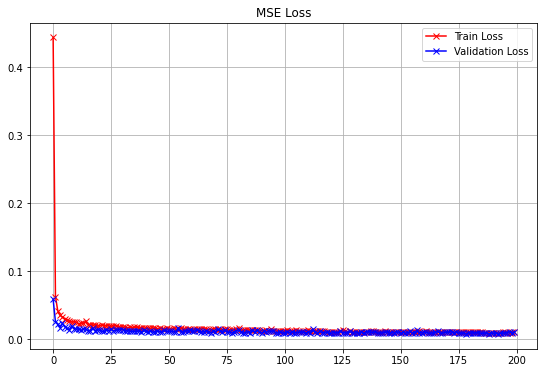

In [189]:
# Train Model
epoch = 200
dropout = 0.05
validation_split = 0.1
batch_size = 200
test_size=0.2
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=test_size, random_state=20)
basereport, basemodel, basehistory = base_model(epoch, batch_size, dropout, validation_split, test_size)
plot_loss_accuracy(basehistory)
basereport

## Plot Predictions for User Input Month and Day for all Buildings

In [15]:
# Prepare Actual CHWTON/SQFT and Base Predictions
date_time = bldgs_df[['Date_Time','Month','Day']]
y_base_model = basemodel.predict(X)
pltres = undummify(X).join(date_time)
y_actual = yscaler.inverse_transform(Y)
pltres['Actual CHWTON/SQFT'] = y_actual
pltres['Time'] = pltres['Date_Time'].str[11:16]
pltres['Baselin Predictions'] = yscaler.inverse_transform(y_base_model)  

[5, 6, 7, 8]
Please select month from options above: 5
[10 16 23 28]
Please select day from options above:  10


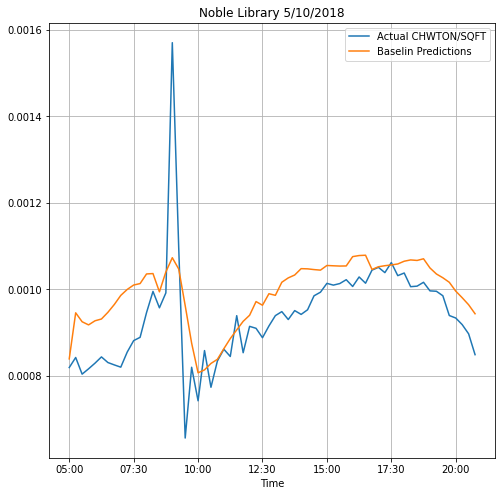

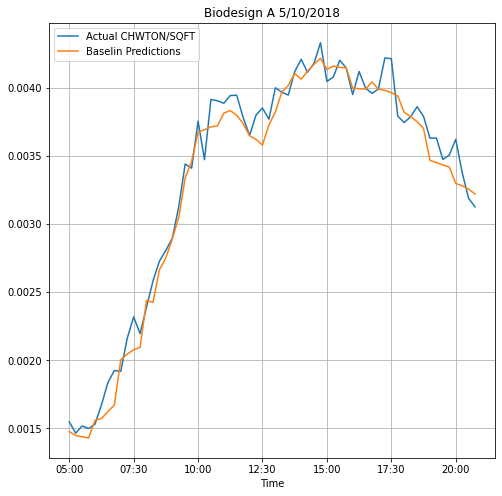

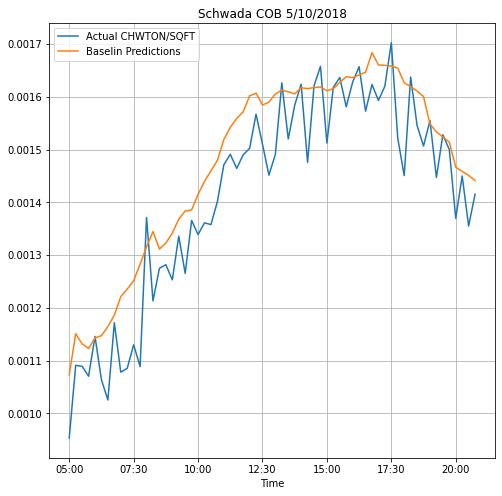

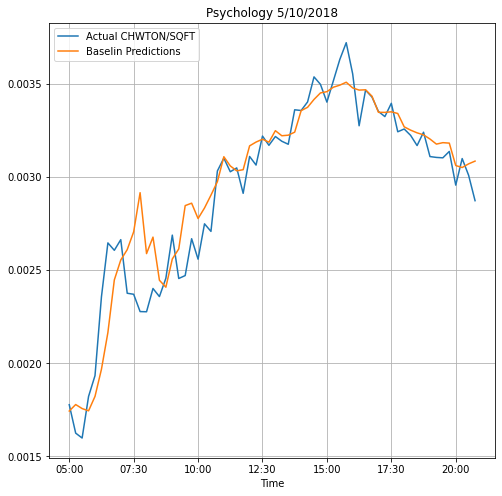

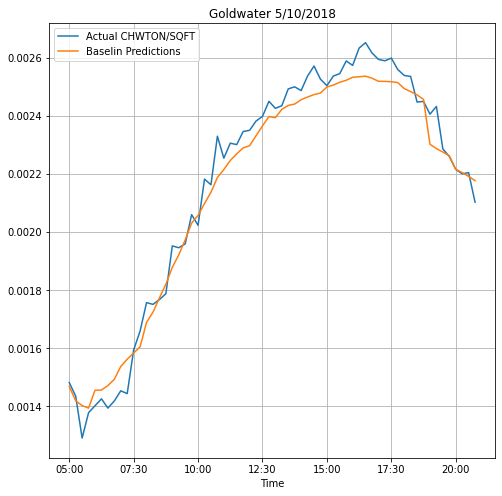

...

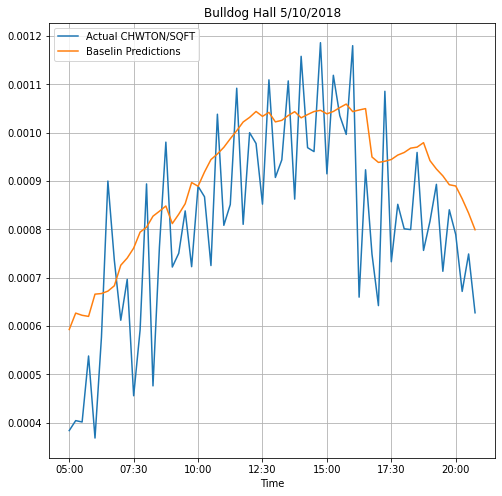

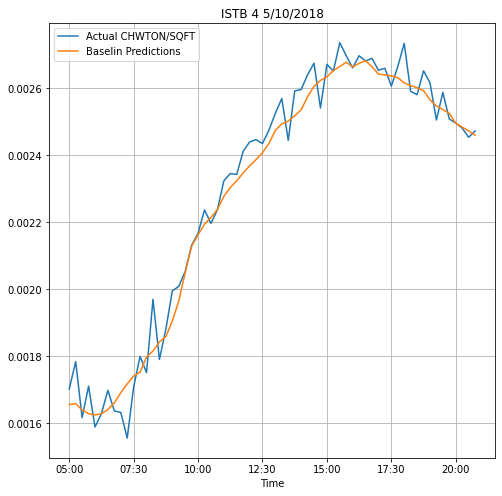

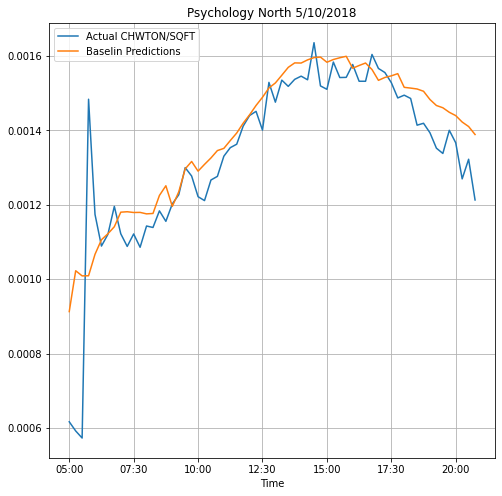

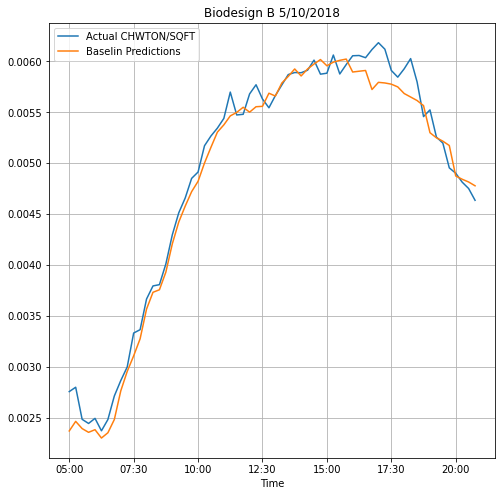

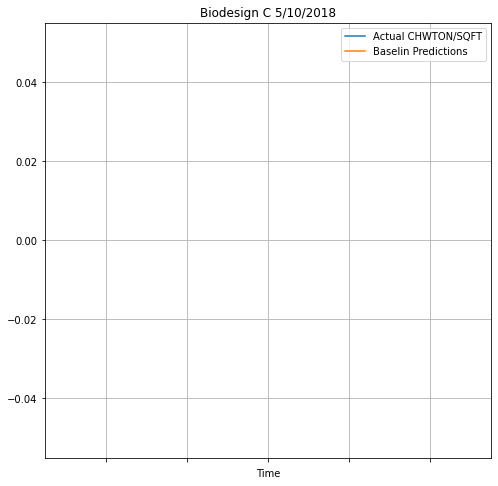

In [16]:
# Ask User to Enter Specific Day
print(list(bldgs_df['Month'].unique()))
m = int(input('Please select month from options above: '))
print(bldgs_df[bldgs_df['Month'] == m]['Day'].unique())
d = int(input('Please select day from options above:  '))

Buildings = pltres['bldgname'].unique()
for bldg in Buildings:             
  month = pltres.loc[pltres['Month'] == m]
  day = month.loc[month['Day'] == d]
  bldg_ = day.loc[pltres['bldgname']==bldg]
  values = bldg_.sort_values(by=['Time'])          
  ax = values.plot(x='Time',y='Actual CHWTON/SQFT', figsize = (8,8))
  values.plot(x='Time',y='Baselin Predictions',figsize = (8,8),ax=ax)
  ax.set_title(bldg + ' ' + str(m) + '/' + str(d) + '/2018' )
  ax.grid(True)

## Save All Prediction Plots for all Days/Months

In [33]:
# Create Models Folder if it Does not Exist
change_scen = int(input('enter [ 1 ] to change scenario:  '))
if change_scen == 1:
  plots_f = '/content/drive/Shareddrives/Microclimate-Building Energy/Plots'
  if os.path.exists(plots_f + '/Models') == False:
    os.mkdir(plots_f + '/Models')
  models_f = plots_f + '/Models/'

  features_name = input('Enter file name for features used: ')
  floc = models_f + features_name

  if os.path.exists(floc) == False:
    os.mkdir(floc)

  for i in ['May 2018', 'June 2018', 'July 2018', 'August 2018']:
    if os.path.exists(floc + '/' + str(i)) == False:
      os.mkdir(floc + '/' + str(i))
else: 
  pass

enter [ 1 ] to change scenario:  1
Enter file name for features used: PCA-Shade-NoArti-NoTimeStep


In [34]:
# Prepare Actual CHWTON/SQFT and Base Predictions
date_time = bldgs_df[['Date_Time','Month','Day']]
y_base_model = basemodel.predict(X)
pltres = undummify(X).join(date_time)
y_actual = yscaler.inverse_transform(Y)
pltres['Actual CHWTON/SQFT'] = y_actual
pltres['Time'] = pltres['Date_Time'].str[11:16]
pltres['Baseline Predictions'] = yscaler.inverse_transform(y_base_model)  

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

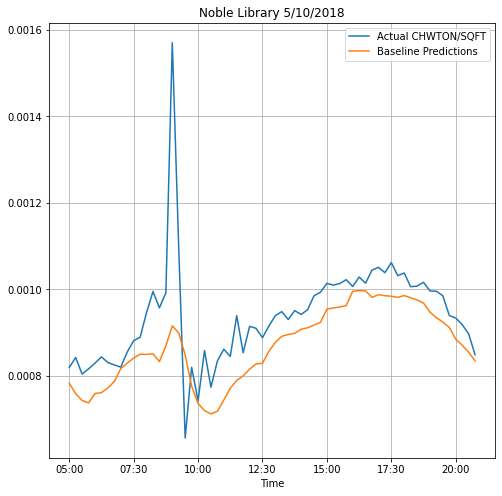

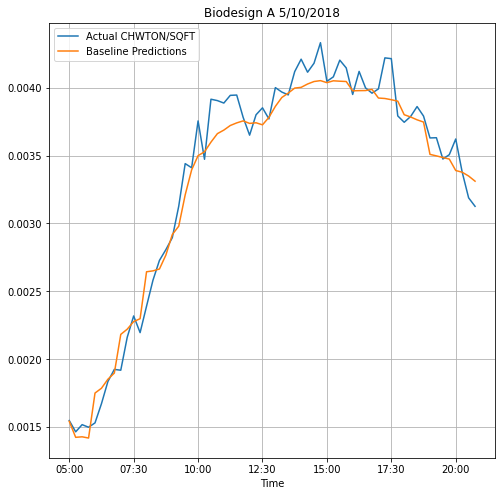

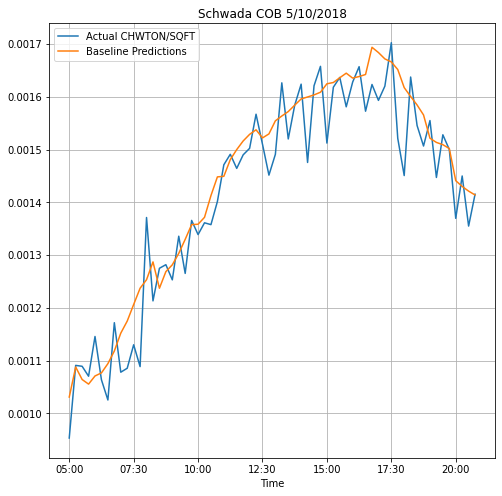

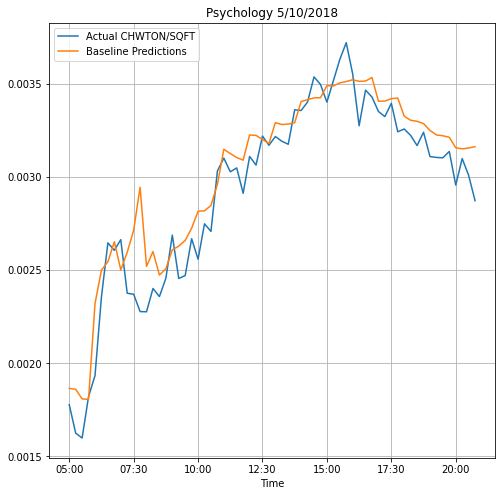

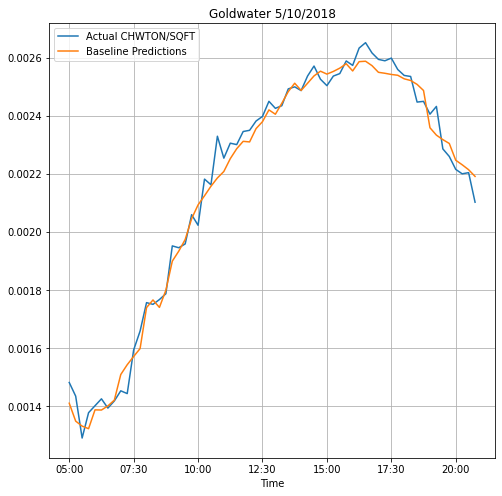

...

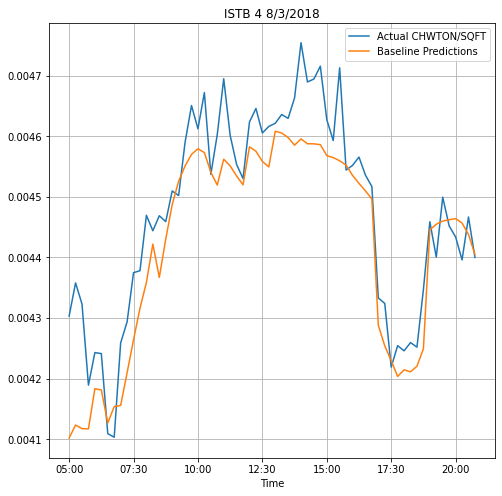

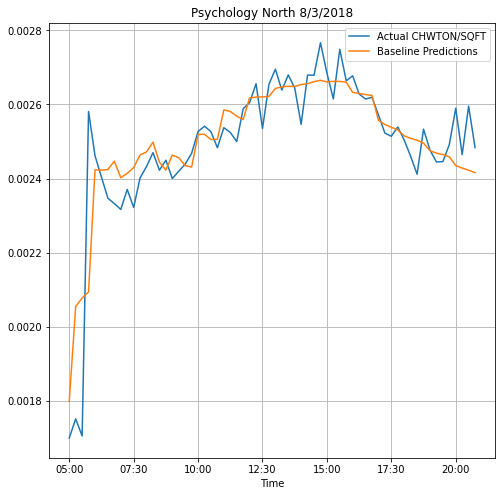

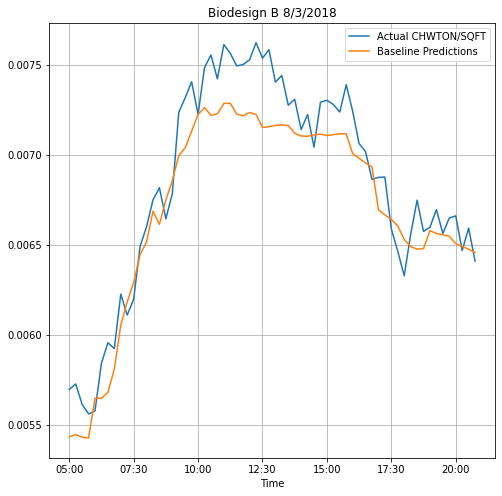

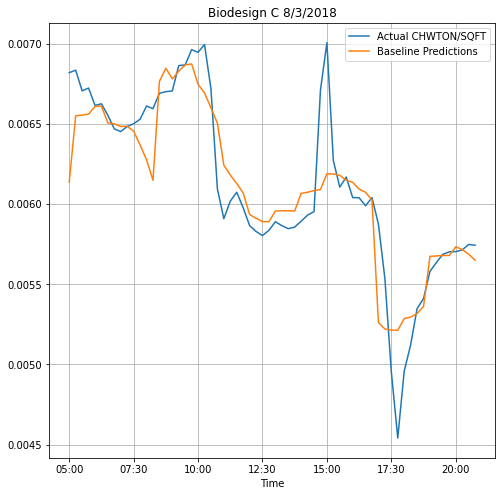

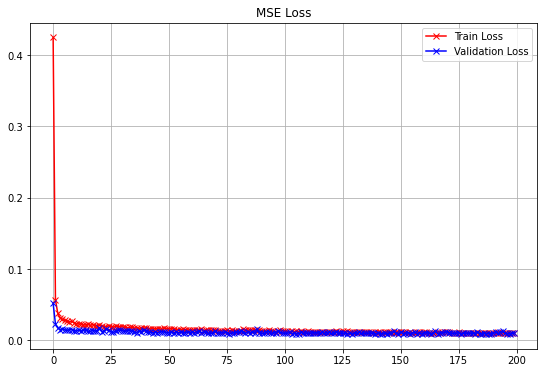

In [35]:
# Get unique months in dataset
unique_m = bldgs_df['Month'].unique()
Buildings = bldgs_df['bldgname'].unique()

# Loop Over Every Day in Data
for m,M in enumerate(unique_m):
  unique_d = bldgs_df[bldgs_df['Month'] == M]['Day'].unique()
  for d,D in enumerate(unique_d):
    # Check month and assign fname
    if str(M) == '5': fname = 'May 2018/'
    elif str(M) == '6': fname = 'June 2018/'
    elif str(M) == '7': fname = 'July 2018/'
    elif str(M) == '8': fname = 'August 2018/'
    for bldg in Buildings:               
      month = pltres.loc[pltres['Month'] == M]
      day = month.loc[month['Day'] == D]
      bldg_ = day.loc[pltres['bldgname']==bldg]
      values = bldg_.sort_values(by=['Time'])          
      ax = values.plot(x='Time',y='Actual CHWTON/SQFT', figsize = (8,8))
      values.plot(x='Time',y='Baseline Predictions',figsize = (8,8),ax=ax)
      ax.set_title(bldg + ' ' + str(M) + '/' + str(D) + '/2018' )
      ax.grid(True)
      plt.savefig(floc + '/' + fname + bldg + ' ' + str(M) + '-' + str(D) + '-2018.png')
basereport.to_csv(floc + '/Summary.csv')
plot_loss_accuracy(basehistory)
plt.savefig(floc + '/epoch_' + str(epoch) + '_loss_curve.png')


## Regularization with Early Stop and Dropout

In [ ]:
data = []
allresults = pd.DataFrame()
for i in range(10):
  dropout = (i+1)*0.01
  for z in range(10):
    epoch = (z+1)*2
    validation_split = 0.1
    batch_size = 200
    test_size=0.2
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=test_size, random_state=20)
    report, model, history = base_model(epoch, batch_size, dropout, validation_split, test_size)
    r2 = round(float(report['R2 Score']), 3)
    RMSE = round(float(report['RMSE']),3)
    values = [dropout, epoch, r2, RMSE]
    zipped = zip(['Dropout', 'Epochs', 'R2 Score', 'RMSE'], values)
    a_dictionary = dict(zipped)
    data.append(a_dictionary)
allresults = allresults.append(data, True)

Epoch 1/2
33/33 [==============================] - 1s 12ms/step - loss: 0.5050 - mean_squared_error: 0.6938 - val_loss: 0.1638 - val_mean_squared_error: 0.4815
Epoch 2/2
33/33 [==============================] - 0s 7ms/step - loss: 0.0953 - mean_squared_error: 0.3641 - val_loss: 0.0540 - val_mean_squared_error: 0.2849
Epoch 1/4
33/33 [==============================] - 1s 12ms/step - loss: 0.5132 - mean_squared_error: 0.7272 - val_loss: 0.1970 - val_mean_squared_error: 0.4914
Epoch 2/4
33/33 [==============================] - 0s 7ms/step - loss: 0.1164 - mean_squared_error: 0.3797 - val_loss: 0.0680 - val_mean_squared_error: 0.3005
Epoch 3/4
33/33 [==============================] - 0s 7ms/step - loss: 0.0554 - mean_squared_error: 0.2541 - val_loss: 0.0351 - val_mean_squared_error: 0.2176
Epoch 4/4
33/33 [==============================] - 0s 6ms/step - loss: 0.0348 - mean_squared_error: 0.1920 - val_loss: 0.0282 - val_mean_squared_error: 0.1714
Epoch 1/6
33/33 [===========================

,Dropout,Epochs,R2 Score,RMSE
0,0.01,2,0.940,0.235
1,0.01,4,0.968,0.172
2,0.01,6,0.969,0.167
3,0.01,8,0.980,0.135
4,0.01,10,0.981,0.131
...,...,...,...,...
95,0.10,12,0.980,0.135
96,0.10,14,0.981,0.131
97,0.10,16,0.980,0.136
98,0.10,18,0.978,0.143


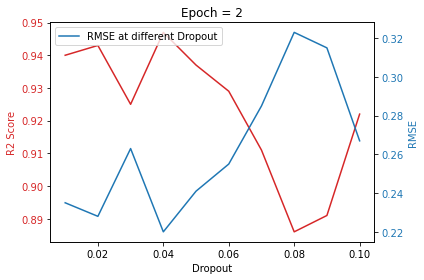

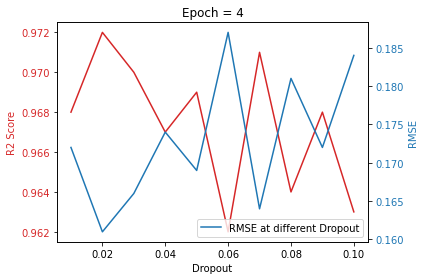

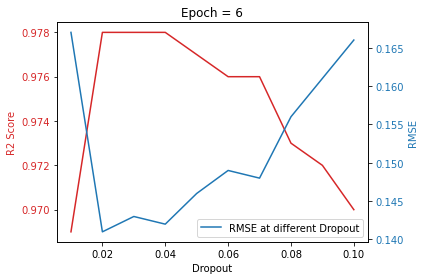

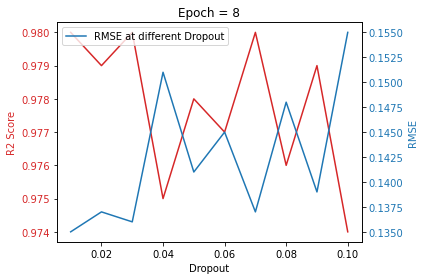

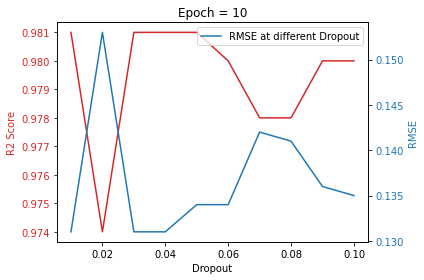

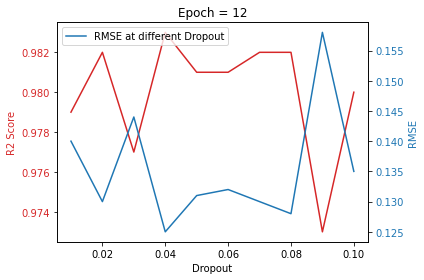

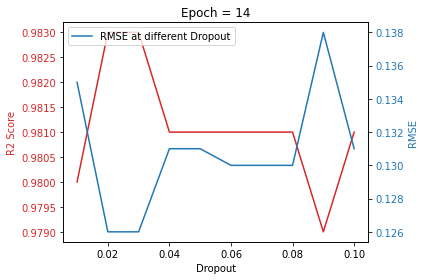

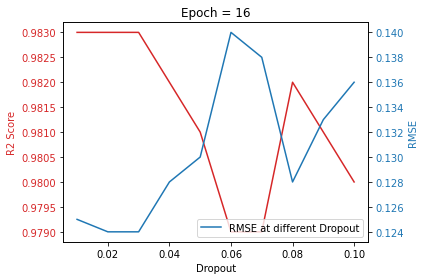

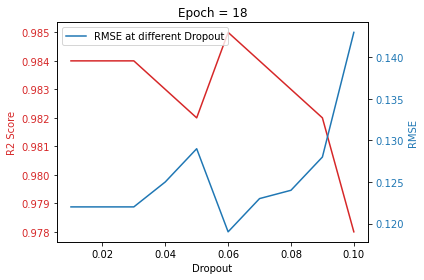

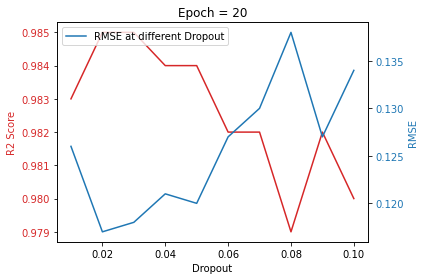

In [ ]:
if os.path.exists(floc + '/Regularization') == False:
  os.mkdir(floc + '/Regularization')
for z in range(10):
  epoch = (z+1)*2
  dropout_df = allresults[allresults['Epochs'] == epoch]

  fig, ax1 = plt.subplots()
  color = 'tab:red'
  ax1.set_xlabel('Dropout')
  ax1.set_ylabel('R2 Score', color=color)
  ax1.plot(dropout_df['Dropout'], dropout_df['R2 Score'], color=color, label='R2 at different Dropout')
  ax1.tick_params(axis='y', labelcolor=color)
  ax2 = ax1.twinx()
  color = 'tab:blue'
  ax2.set_ylabel('RMSE', color=color)
  ax2.plot(dropout_df['Dropout'], dropout_df['RMSE'], color=color, label='RMSE at different Dropout')
  ax2.tick_params(axis='y', labelcolor=color)
  plt.title('Epoch = ' + str(epoch))
  plt.legend()
  fig.tight_layout()

  # Save Figures
  plt.savefig(floc + '/Regularization/' + 'R2-RMSE-vs-dropout_for_epoch_' + str(epoch) + '.png')

allresults.to_csv(floc + '/Regularization/' + 'allresults.csv')
allresults

## Train/Validate and Test on Each Day

Epoch 1/50
37/37 [==============================] - 1s 12ms/step - loss: 0.4492 - mean_squared_error: 0.6847 - val_loss: 0.0911 - val_mean_squared_error: 0.4240
Epoch 2/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0725 - mean_squared_error: 0.3161 - val_loss: 0.0299 - val_mean_squared_error: 0.2442
Epoch 3/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0419 - mean_squared_error: 0.2054 - val_loss: 0.0207 - val_mean_squared_error: 0.1754
Epoch 4/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0347 - mean_squared_error: 0.1559 - val_loss: 0.0196 - val_mean_squared_error: 0.1396
Epoch 5/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0319 - mean_squared_error: 0.1280 - val_loss: 0.0182 - val_mean_squared_error: 0.1176
Epoch 6/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0282 - mean_squared_error: 0.1097 - val_loss: 0.0232 - val_mean_squared_error: 0.1025
Epoch 7/50
37/37 [=====================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

Epoch 1/50
37/37 [==============================] - 1s 13ms/step - loss: 0.4985 - mean_squared_error: 0.7516 - val_loss: 0.0848 - val_mean_squared_error: 0.4694
Epoch 2/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0751 - mean_squared_error: 0.3478 - val_loss: 0.0355 - val_mean_squared_error: 0.2678
Epoch 3/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0471 - mean_squared_error: 0.2260 - val_loss: 0.0237 - val_mean_squared_error: 0.1928
Epoch 4/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0376 - mean_squared_error: 0.1713 - val_loss: 0.0203 - val_mean_squared_error: 0.1533
Epoch 5/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0358 - mean_squared_error: 0.1404 - val_loss: 0.0242 - val_mean_squared_error: 0.1294
Epoch 6/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0317 - mean_squared_error: 0.1208 - val_loss: 0.0183 - val_mean_squared_error: 0.1128
Epoch 7/50
37/37 [=====================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

Epoch 1/50
37/37 [==============================] - 1s 12ms/step - loss: 0.4403 - mean_squared_error: 0.6985 - val_loss: 0.0927 - val_mean_squared_error: 0.4157
Epoch 2/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0784 - mean_squared_error: 0.3137 - val_loss: 0.0266 - val_mean_squared_error: 0.2428
Epoch 3/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0441 - mean_squared_error: 0.2050 - val_loss: 0.0196 - val_mean_squared_error: 0.1751
Epoch 4/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0357 - mean_squared_error: 0.1557 - val_loss: 0.0200 - val_mean_squared_error: 0.1396
Epoch 5/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0337 - mean_squared_error: 0.1281 - val_loss: 0.0191 - val_mean_squared_error: 0.1180
Epoch 6/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0304 - mean_squared_error: 0.1102 - val_loss: 0.0167 - val_mean_squared_error: 0.1031
Epoch 7/50
37/37 [=====================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

Epoch 1/50
37/37 [==============================] - 1s 14ms/step - loss: 0.5194 - mean_squared_error: 0.7337 - val_loss: 0.1252 - val_mean_squared_error: 0.4917
Epoch 2/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0851 - mean_squared_error: 0.3685 - val_loss: 0.0338 - val_mean_squared_error: 0.2839
Epoch 3/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0462 - mean_squared_error: 0.2388 - val_loss: 0.0257 - val_mean_squared_error: 0.2032
Epoch 4/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0379 - mean_squared_error: 0.1804 - val_loss: 0.0206 - val_mean_squared_error: 0.1612
Epoch 5/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0330 - mean_squared_error: 0.1474 - val_loss: 0.0220 - val_mean_squared_error: 0.1351
Epoch 6/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0306 - mean_squared_error: 0.1259 - val_loss: 0.0179 - val_mean_squared_error: 0.1174
Epoch 7/50
37/37 [=====================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

Epoch 1/50
37/37 [==============================] - 1s 14ms/step - loss: 0.5128 - mean_squared_error: 0.7327 - val_loss: 0.1639 - val_mean_squared_error: 0.4881
Epoch 2/50
37/37 [==============================] - 0s 10ms/step - loss: 0.0972 - mean_squared_error: 0.3727 - val_loss: 0.0332 - val_mean_squared_error: 0.2884
Epoch 3/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0505 - mean_squared_error: 0.2432 - val_loss: 0.0219 - val_mean_squared_error: 0.2074
Epoch 4/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0400 - mean_squared_error: 0.1842 - val_loss: 0.0200 - val_mean_squared_error: 0.1647
Epoch 5/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0348 - mean_squared_error: 0.1506 - val_loss: 0.0198 - val_mean_squared_error: 0.1383
Epoch 6/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0319 - mean_squared_error: 0.1289 - val_loss: 0.0189 - val_mean_squared_error: 0.1202
Epoch 7/50
37/37 [====================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

Epoch 1/50
37/37 [==============================] - 1s 13ms/step - loss: 0.5407 - mean_squared_error: 0.7948 - val_loss: 0.1121 - val_mean_squared_error: 0.5102
Epoch 2/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0759 - mean_squared_error: 0.3776 - val_loss: 0.0398 - val_mean_squared_error: 0.2889
Epoch 3/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0419 - mean_squared_error: 0.2418 - val_loss: 0.0221 - val_mean_squared_error: 0.2052
Epoch 4/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0340 - mean_squared_error: 0.1814 - val_loss: 0.0201 - val_mean_squared_error: 0.1618
Epoch 5/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0322 - mean_squared_error: 0.1477 - val_loss: 0.0193 - val_mean_squared_error: 0.1354
Epoch 6/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0275 - mean_squared_error: 0.1258 - val_loss: 0.0181 - val_mean_squared_error: 0.1172
Epoch 7/50
37/37 [=====================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

Epoch 1/50
37/37 [==============================] - 1s 12ms/step - loss: 0.5263 - mean_squared_error: 0.7796 - val_loss: 0.0959 - val_mean_squared_error: 0.4956
Epoch 2/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0903 - mean_squared_error: 0.3706 - val_loss: 0.0397 - val_mean_squared_error: 0.2881
Epoch 3/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0478 - mean_squared_error: 0.2420 - val_loss: 0.0277 - val_mean_squared_error: 0.2066
Epoch 4/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0403 - mean_squared_error: 0.1836 - val_loss: 0.0221 - val_mean_squared_error: 0.1643
Epoch 5/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0337 - mean_squared_error: 0.1501 - val_loss: 0.0216 - val_mean_squared_error: 0.1378
Epoch 6/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0312 - mean_squared_error: 0.1283 - val_loss: 0.0197 - val_mean_squared_error: 0.1197
Epoch 7/50
37/37 [=====================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

Epoch 1/50
37/37 [==============================] - 1s 13ms/step - loss: 0.4476 - mean_squared_error: 0.6688 - val_loss: 0.0959 - val_mean_squared_error: 0.4226
Epoch 2/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0802 - mean_squared_error: 0.3188 - val_loss: 0.0326 - val_mean_squared_error: 0.2473
Epoch 3/50
37/37 [==============================] - 0s 7ms/step - loss: 0.0443 - mean_squared_error: 0.2083 - val_loss: 0.0283 - val_mean_squared_error: 0.1784
Epoch 4/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0350 - mean_squared_error: 0.1587 - val_loss: 0.0223 - val_mean_squared_error: 0.1420
Epoch 5/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0323 - mean_squared_error: 0.1301 - val_loss: 0.0201 - val_mean_squared_error: 0.1197
Epoch 6/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0287 - mean_squared_error: 0.1116 - val_loss: 0.0187 - val_mean_squared_error: 0.1043
Epoch 7/50
37/37 [=====================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

Epoch 1/50
37/37 [==============================] - 1s 14ms/step - loss: 0.4352 - mean_squared_error: 0.6529 - val_loss: 0.1018 - val_mean_squared_error: 0.4115
Epoch 2/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0716 - mean_squared_error: 0.3081 - val_loss: 0.0318 - val_mean_squared_error: 0.2379
Epoch 3/50
37/37 [==============================] - 0s 10ms/step - loss: 0.0475 - mean_squared_error: 0.2011 - val_loss: 0.0526 - val_mean_squared_error: 0.1738
Epoch 4/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0417 - mean_squared_error: 0.1561 - val_loss: 0.0230 - val_mean_squared_error: 0.1402
Epoch 5/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0333 - mean_squared_error: 0.1287 - val_loss: 0.0208 - val_mean_squared_error: 0.1185
Epoch 6/50
37/37 [==============================] - 0s 11ms/step - loss: 0.0303 - mean_squared_error: 0.1106 - val_loss: 0.0212 - val_mean_squared_error: 0.1035
Epoch 7/50
37/37 [===================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

Epoch 1/50
39/39 [==============================] - 1s 12ms/step - loss: 0.4855 - mean_squared_error: 0.6964 - val_loss: 0.0969 - val_mean_squared_error: 0.4588
Epoch 2/50
39/39 [==============================] - 0s 8ms/step - loss: 0.0750 - mean_squared_error: 0.3401 - val_loss: 0.0317 - val_mean_squared_error: 0.2625
Epoch 3/50
39/39 [==============================] - 0s 8ms/step - loss: 0.0392 - mean_squared_error: 0.2192 - val_loss: 0.0240 - val_mean_squared_error: 0.1868
Epoch 4/50
39/39 [==============================] - 0s 7ms/step - loss: 0.0349 - mean_squared_error: 0.1654 - val_loss: 0.0225 - val_mean_squared_error: 0.1482
Epoch 5/50
39/39 [==============================] - 0s 8ms/step - loss: 0.0310 - mean_squared_error: 0.1352 - val_loss: 0.0234 - val_mean_squared_error: 0.1244
Epoch 6/50
39/39 [==============================] - 0s 8ms/step - loss: 0.0287 - mean_squared_error: 0.1158 - val_loss: 0.0275 - val_mean_squared_error: 0.1083
Epoch 7/50
39/39 [=====================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

Epoch 1/50
37/37 [==============================] - 2s 28ms/step - loss: 0.4849 - mean_squared_error: 0.7073 - val_loss: 0.1072 - val_mean_squared_error: 0.4581
Epoch 2/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0771 - mean_squared_error: 0.3423 - val_loss: 0.0437 - val_mean_squared_error: 0.2639
Epoch 3/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0451 - mean_squared_error: 0.2224 - val_loss: 0.0218 - val_mean_squared_error: 0.1896
Epoch 4/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0342 - mean_squared_error: 0.1681 - val_loss: 0.0204 - val_mean_squared_error: 0.1501
Epoch 5/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0294 - mean_squared_error: 0.1371 - val_loss: 0.0198 - val_mean_squared_error: 0.1256
Epoch 6/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0282 - mean_squared_error: 0.1170 - val_loss: 0.0178 - val_mean_squared_error: 0.1092
Epoch 7/50
37/37 [=====================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

Epoch 1/50
37/37 [==============================] - 1s 13ms/step - loss: 0.3963 - mean_squared_error: 0.6263 - val_loss: 0.0963 - val_mean_squared_error: 0.3749
Epoch 2/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0688 - mean_squared_error: 0.2819 - val_loss: 0.0299 - val_mean_squared_error: 0.2186
Epoch 3/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0372 - mean_squared_error: 0.1837 - val_loss: 0.0185 - val_mean_squared_error: 0.1570
Epoch 4/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0303 - mean_squared_error: 0.1394 - val_loss: 0.0164 - val_mean_squared_error: 0.1247
Epoch 5/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0280 - mean_squared_error: 0.1141 - val_loss: 0.0163 - val_mean_squared_error: 0.1050
Epoch 6/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0266 - mean_squared_error: 0.0980 - val_loss: 0.0156 - val_mean_squared_error: 0.0917
Epoch 7/50
37/37 [=====================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

Epoch 1/50
37/37 [==============================] - 1s 12ms/step - loss: 0.3986 - mean_squared_error: 0.6068 - val_loss: 0.0868 - val_mean_squared_error: 0.3766
Epoch 2/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0756 - mean_squared_error: 0.2849 - val_loss: 0.0288 - val_mean_squared_error: 0.2222
Epoch 3/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0414 - mean_squared_error: 0.1875 - val_loss: 0.0199 - val_mean_squared_error: 0.1607
Epoch 4/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0374 - mean_squared_error: 0.1436 - val_loss: 0.0198 - val_mean_squared_error: 0.1292
Epoch 5/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0312 - mean_squared_error: 0.1185 - val_loss: 0.0171 - val_mean_squared_error: 0.1092
Epoch 6/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0286 - mean_squared_error: 0.1019 - val_loss: 0.0164 - val_mean_squared_error: 0.0955
Epoch 7/50
37/37 [=====================

/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

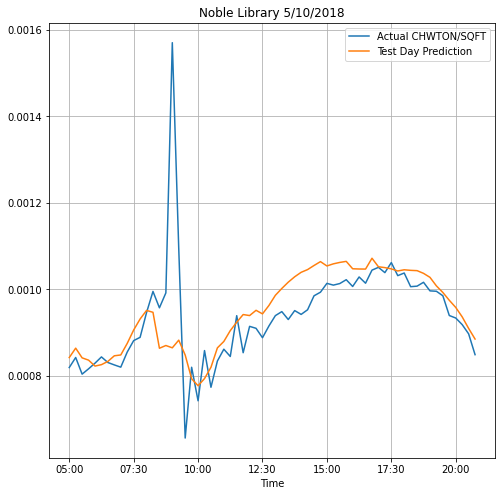

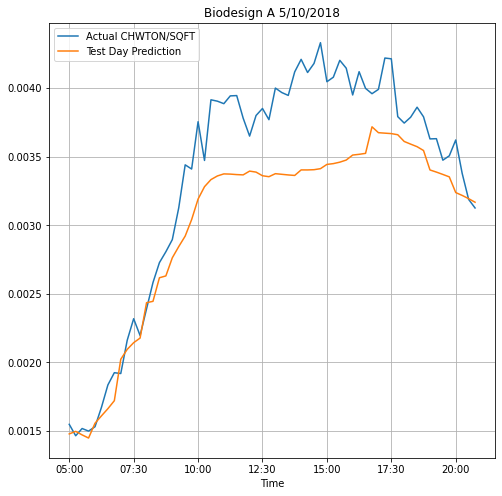

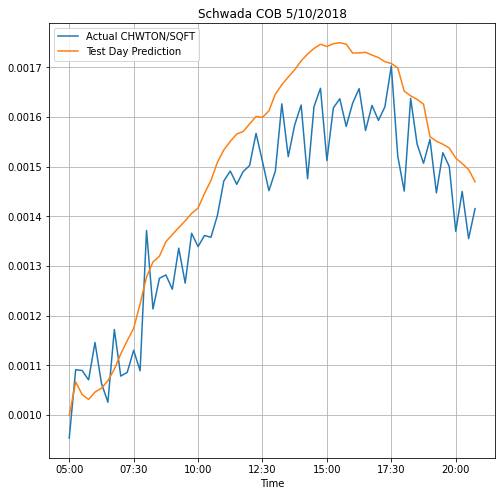

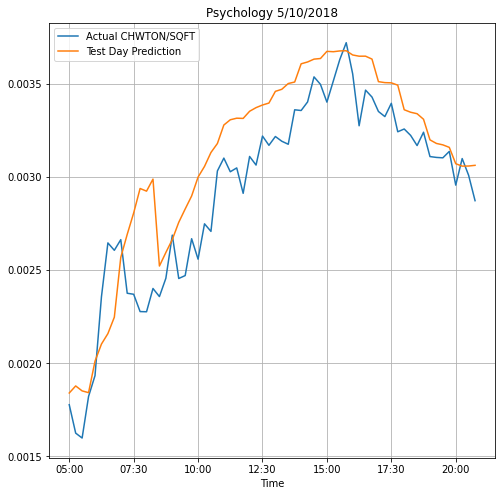

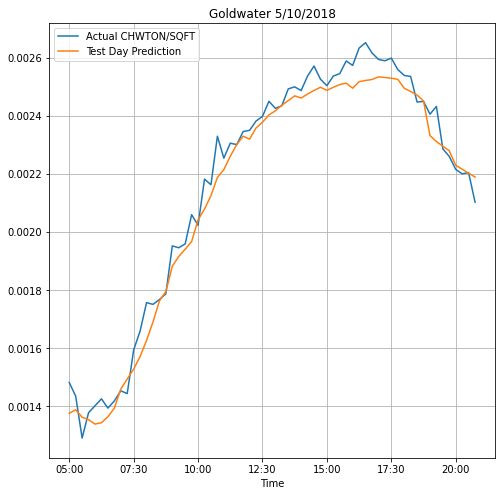

...

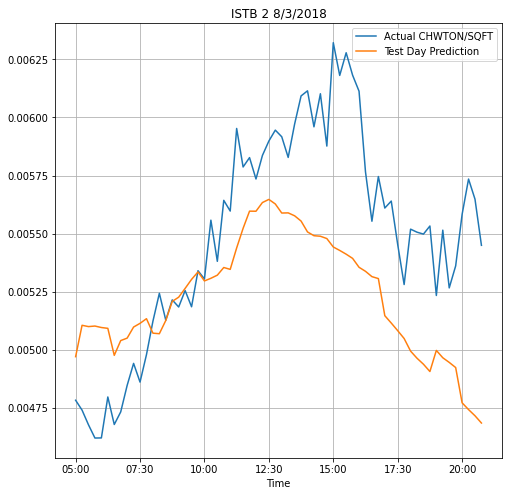

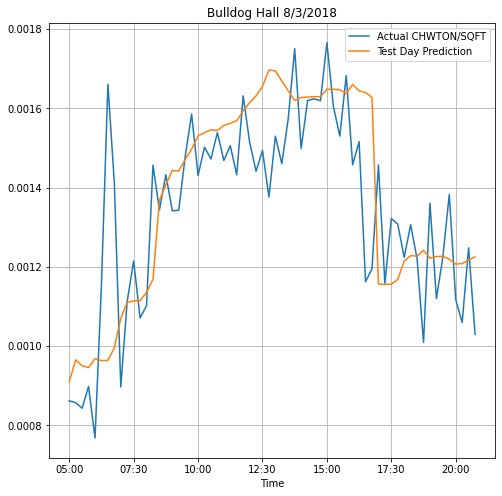

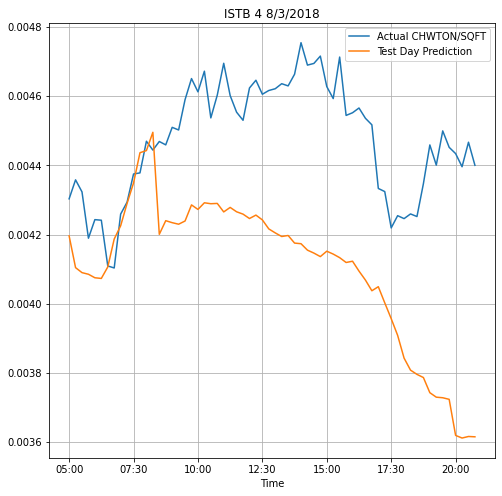

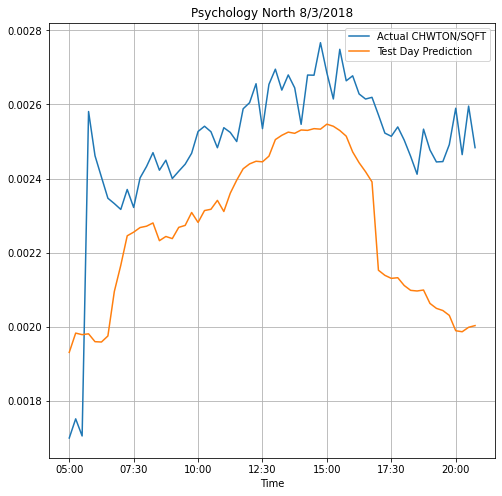

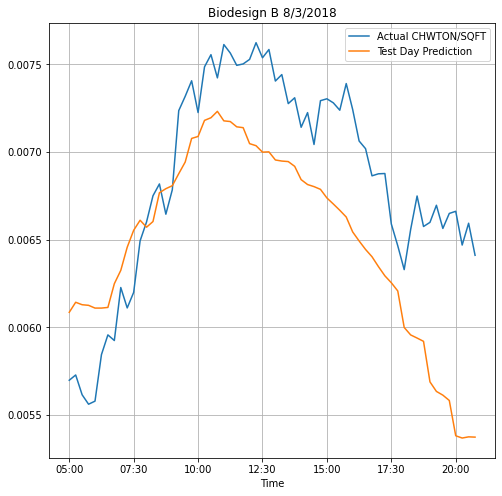

In [ ]:
if os.path.exists(floc + '/One-Day-Test') == False: 
  os.mkdir(floc + '/One-Day-Test')
# Define Empty List
data = []
# Get unique months in dataset
unique_m = bldgs_df['Month'].unique()

# Loop Over Every Day in Data
for m,M in enumerate(unique_m):
  unique_d = bldgs_df[bldgs_df['Month'] == M]['Day'].unique()
  for d,D in enumerate(unique_d):

    # Copy original data, save current day to df_test, remove current day from df
    df = bldgs_df.copy()
    df_test = df[(df['Month']==M) & (df['Day']==D)]
    df.drop(df[(df['Month']==M) & (df['Day']==D)].index, inplace = True)

    # Define X for train/validate and X_test_day for testing
    X = df[cols+cols_]
    X_test_day = df_test[cols+cols_]
    X = pd.get_dummies(X)
    X_test_day = pd.get_dummies(X_test_day)

    # Add Biodesign C one-hot-encoded for days before June 20 as they are not available in original data
    if (M < 6) or (D == 8) or (D == 9) or (M < 7 & D < 20):
      X_test_day['bldgname_Biodesign C'] = 0
      col = X_test_day.pop('bldgname_Biodesign C')
      X_test_day.insert(2, 'bldgname_Biodesign C', col)

    # Rearrange X Data
    X = X[bldg_cols + scols + cols_]
    X_test_day = X_test_day[bldg_cols + scols + cols_]

    # Define Y for train/validate and Y_test_day for testing
    Y = df['CHWTON/SQFT']
    Y_test_day = df_test['CHWTON/SQFT']
    Y_test_day = Y_test_day.values.reshape(-1, 1)
    Y = Y.values.reshape(-1, 1)
    Y = yscaler.transform(Y)
    Y_test_day = yscaler.transform(Y_test_day)

    # Split Data Into Train/Test --> note: X_test/y_test here is used for validation since we are testing on removed day
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.1, random_state=20)

    # Train Model
    epoch = 50
    dropout = 0.05
    validation_split = 0.1
    batch_size = 200
    test_size=0.2 
    report, model, history = base_model(epoch, batch_size, dropout, validation_split, test_size)

    # Predict test day 
    y_day_preds = model.predict(X_test_day)

    # Save validation and test day R2 and RMSE scores
    RMSE_day = np.sqrt(metrics.mean_squared_error(Y_test_day, y_day_preds))
    R2_score_day = metrics.r2_score(Y_test_day, y_day_preds) 
    data.append([str(M) + '/' + str(D), float(report['R2 Score']), R2_score_day])  
    print('Epoch Complete')

    # Preparing data for plotting
    date_time = df_test[['Date_Time','Month','Day']]
    res = undummify(X_test_day).join(date_time)
    Y_actual = yscaler.inverse_transform(Y_test_day)
    res['Actual CHWTON/SQFT'] = Y_actual
    res['Time'] = res['Date_Time'].str[11:16]
    res['Test Day Prediction'] = yscaler.inverse_transform(y_day_preds)  

    # Plotting results for all days for each building   
    Buildings = res['bldgname'].unique()
    for bldg in Buildings:
      month = res.loc[res['Month'] == M]
      day = month.loc[month['Day'] == D]
      bldg_ = day.loc[res['bldgname']==bldg]
      values = bldg_.sort_values(by=['Time'])          
      ax = values.plot(x='Time',y='Actual CHWTON/SQFT', figsize = (8,8))
      values.plot(x='Time',y='Test Day Prediction',figsize = (8,8),ax=ax)
      ax.set_title(bldg + ' ' + str(M) + '/' + str(D) + '/2018' )
      ax.grid(True)
      plt.savefig(floc + '/One-Day-Test/' + bldg + '_' + str(M) + '-' + str(D) + '-2018.png', bbox_inches='tight')
column_names = ["Day Removed", "Validation R2", "Test Day R2"]
results = pd.DataFrame(data, columns = column_names)
results.to_csv(floc + '/One-Day-Test/Summary.csv')

In [ ]:
results

,Day Removed,Validation R2,Test Day R2
0,5/16,0.980606,0.805352
1,5/23,0.983530,0.795664
2,5/28,0.980578,0.766195
3,6/7,0.982028,0.850129
4,6/8,0.979461,0.872148
5,6/20,0.983585,0.943277
6,6/21,0.982902,0.975283
7,6/25,0.981527,0.951802
8,6/26,0.981828,0.977910
9,6/27,0.981320,0.969353


# **Sensitivity Analysis**

In [ ]:
# Create Sensitivity Analysis Folder if it Does not Exist
if os.path.exists(floc + '/Sensitivity Analysis') == False:
  os.mkdir(floc + '/Sensitivity Analysis')

## Define Scenario and Create Output Files

In [ ]:
# Ask user to input microclimate modifications
shadered = float(input('Shade to add (0 - 1): '))
airtempred = float(input('Air Temperature Reduction (C) (1 = -1C): '))
abshumred = float(input('Absolute Humidity Reduction: '))
scenname = scenarios[feat_type - 1]
unique_id = "( " + str(airtempred) + "C, " + str(abshumred) + "AH, " + str(shadered) + "S )"

# Get Shade Scenarios Ready
# West Facade
WestShade = Data.copy()
WestShade = change_shade(WestShade, [shadered], ['Shade West'])
WestShade['Shade PCA'] = pca_conversion(WestShade, shade_cols, PCA_Shade_instance)
# East Facade
EastShade = Data.copy()
EastShade = change_shade(EastShade, [shadered], ['Shade East'])
EastShade['Shade PCA'] = pca_conversion(EastShade, shade_cols, PCA_Shade_instance)
# North Facade
NorthShade = Data.copy()
NorthShade = change_shade(NorthShade, [shadered], ['Shade North'])
NorthShade['Shade PCA'] = pca_conversion(NorthShade, shade_cols, PCA_Shade_instance)
# Sourth Facade
SouthShade = Data.copy()
SouthShade = change_shade(SouthShade, [shadered], ['Shade South'])
SouthShade['Shade PCA'] = pca_conversion(SouthShade, shade_cols, PCA_Shade_instance)
# All Facades
AllShade = Data.copy()
AllShade = change_shade(AllShade, shadered, 'All')
AllShade['Shade PCA'] = pca_conversion(AllShade, shade_cols, PCA_Shade_instance)

# Get Air Temp Scenario Ready
AirTempRed = Data.copy()
AirTempRed = df_airT_absH(AirTempRed, airtempred, 0)

# Get Abs Hum Scenario Ready
AbsHumRed = Data.copy()
AbsHumRed = df_airT_absH(AbsHumRed, 0, abshumred)

# Get All Combined Scenario Ready
AllCombined = AllShade.copy()
AllCombined = df_airT_absH(AllCombined, airtempred, abshumred)

Shade to add (0 - 1): 0.5
Air Temperature Reduction (C) (1 = -1C): 1
Absolute Humidity Reduction: 1


In [ ]:
scendic = {
  "1": "Reduce Shade East " + str(shadered),
  "2": "Reduce Shade West " + str(shadered),
  "3": "Reduce Shade South " + str(shadered),
  "4": "Reduce Shade North " + str(shadered),
  "5": "Reduce Shade All " + str(shadered),
  "6": "Reduce Air Temp " + str(airtempred) + "C",
  "7": "Reduce Abs Hum " + str(abshumred),
  "8": "All Scenarios Combined " + "( " + str(airtempred) + "C, " + str(abshumred) + "AH, " + str(shadered) + "S )",
}

print('THE FOLLOWING SCENARIOS WILL BE MODELED:')
for i in scendic: 
  print('[', i, ']', scendic[i])

unique_floc = floc + '/Sensitivity Analysis/' + unique_id

# Create Scenario Files with Date Files if they Do not Exist
if os.path.exists(unique_floc) == False:
  os.mkdir(unique_floc)

  for z in scendic:
    os.mkdir(floc + '/Sensitivity Analysis/' + unique_id + '/' + str(scendic[z]))
    for i in ['May 2018', 'June 2018', 'July 2018', 'August 2018']:
      os.mkdir(floc + '/Sensitivity Analysis/' + unique_id + '/' + str(scendic[z]) + '/' + str(i))

THE FOLLOWING SCENARIOS WILL BE MODELED:
[ 1 ] Reduce Shade East 0.5
[ 2 ] Reduce Shade West 0.5
[ 3 ] Reduce Shade South 0.5
[ 4 ] Reduce Shade North 0.5
[ 5 ] Reduce Shade All 0.5
[ 6 ] Reduce Air Temp 1.0C
[ 7 ] Reduce Abs Hum 1.0
[ 8 ] All Scenarios Combined ( 1.0C, 1.0AH, 0.5S )


## Prepare Base Predictions and Actual CHWTON/SQFT Data

In [ ]:
# Run Base Model Defining before to make sure correct X and Y data loaded
y_base_model = basemodel.predict(X)
y_base_model = yscaler.inverse_transform(y_base_model)
y_actual = yscaler.inverse_transform(Y)

y_actual_and_base = pd.DataFrame(y_actual, columns = ['Actual CHWTON/SQFT'])
y_actual_and_base['Baseline Predictions'] = y_base_model
date_time = bldgs_df[['Date_Time','Month','Day','bldgname']]
date_time['Time'] = date_time['Date_Time'].str[11:16]

y_actual_and_base = y_actual_and_base.join(date_time)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':


## Run All Combinations of Defined Scenarios

In [ ]:
scendf = [EastShade, WestShade, SouthShade, NorthShade, AllShade, AirTempRed, AbsHumRed, AllCombined]
scen_output = []
for i, Sdf in enumerate(scendf):
  df = Sdf.copy()
  df = df_airT_absH(df, 0,0)
  # Loop over scenarios
  X_Scenario = df
  X_Scenario[scols] = xscaler.transform(X_Scenario[scols])

  # Perform Data Shift for each building and dropna
  buildings = X_Scenario['bldgname'].unique()
  unique_m = X_Scenario['Month'].unique()
  bldg_list = []
  # Loop Over Every Day in Data
  for m,M in enumerate(unique_m):
    unique_d = bldgs_df[bldgs_df['Month'] == M]['Day'].unique()
    for d,D in enumerate(unique_d):
      for b,B in enumerate(buildings):
        bldg_scen_df = X_Scenario[X_Scenario['bldgname']== B].copy()
        month = bldg_scen_df.loc[bldg_scen_df['Month'] == M]
        day = month.loc[month['Day'] == D]
        day = df_airT_absH(day, 0,0)
        day, cols_ = time_shift(day, shift_, scols)
        day = day.dropna()
        bldg_list.append(day)
  bldgs_scen_df = bldg_list[0]
  for z in range(len(bldg_list)-1):
    bldgs_scen_df = bldgs_scen_df.append(bldg_list[z+1])

  # Assign Y 
  Y_scen = bldgs_scen_df['CHWTON/SQFT']
  Y_scen = Y_scen.values.reshape(-1, 1)
  Y_scen = yscaler.transform(Y_scen)

  # Use to rearrange X data
  bldg_cols = ['bldgname_Biodesign A', 'bldgname_Biodesign B', 'bldgname_Biodesign C',
                'bldgname_Bulldog Hall', 'bldgname_Goldwater', 'bldgname_ISTB 2',
                'bldgname_ISTB 4', 'bldgname_Noble Library', 'bldgname_Psychology',
                'bldgname_Psychology North', 'bldgname_Schwada COB']

  # Assign X
  X_Scenario = bldgs_scen_df[cols + cols_]
  X_Scenario = pd.get_dummies(X_Scenario)
  X_Scenario = X_Scenario[bldg_cols].join(X_Scenario[X_Scenario.columns[:len(cols+cols_)-1]])


  # Predict Scenario
  y_scen_preds = basemodel.predict(X_Scenario)
  y_scen_preds = yscaler.inverse_transform(y_scen_preds)

  # Save Scenario Scores
  RMSE = np.sqrt(metrics.mean_squared_error(Y_scen, y_scen_preds))
  R2_score = metrics.r2_score(Y, y_scen_preds)
  report = pd.DataFrame({'R2 Score': [R2_score], 'RMSE':[RMSE]})
  scen_output.append(pd.DataFrame(y_scen_preds, columns = [scendic[str(i+1)]]).join(y_actual_and_base))

In [ ]:
scen_output[0]

## Plot and Save

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in float_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in float_scalars
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = 

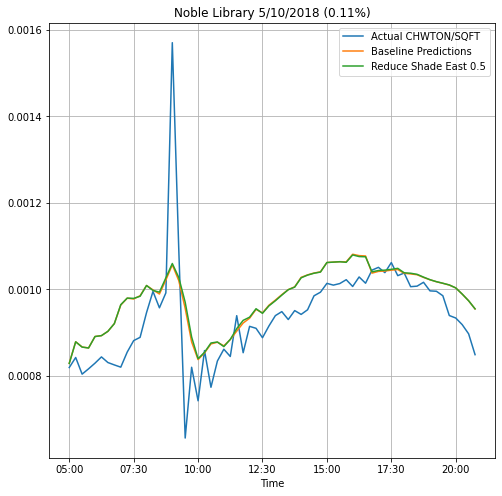

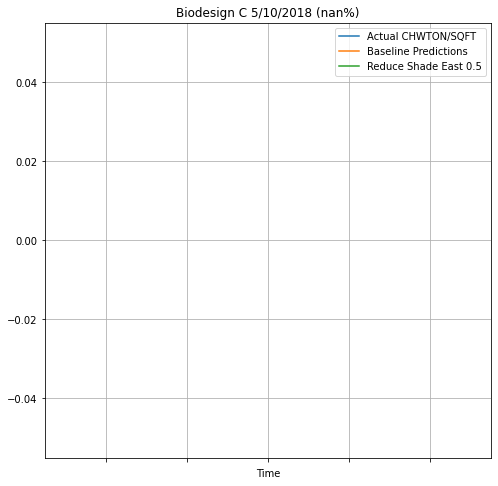

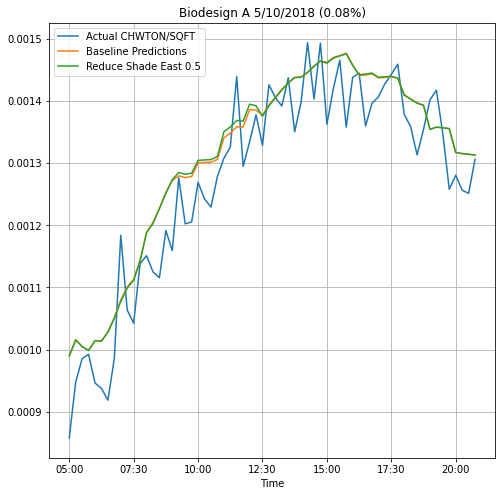

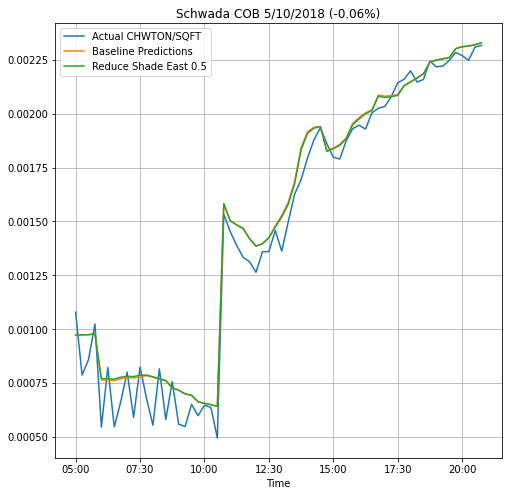

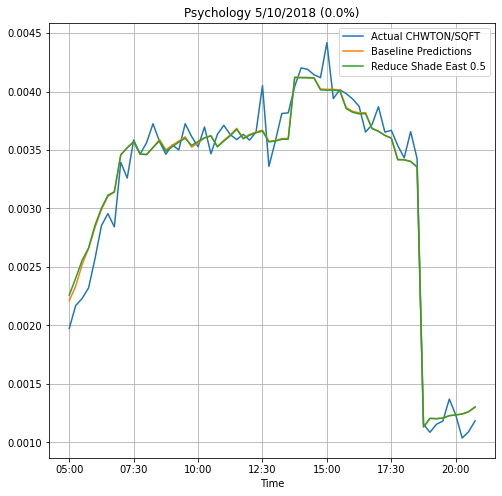

...

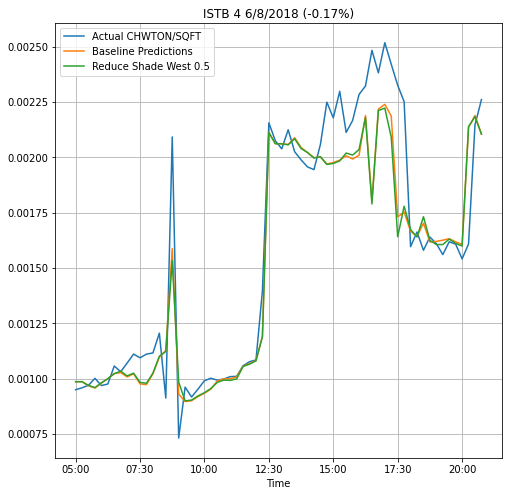

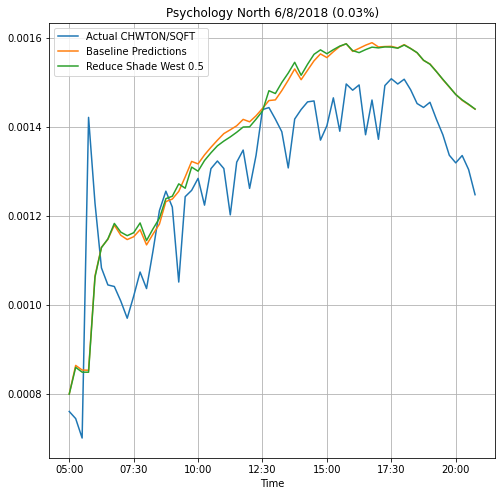

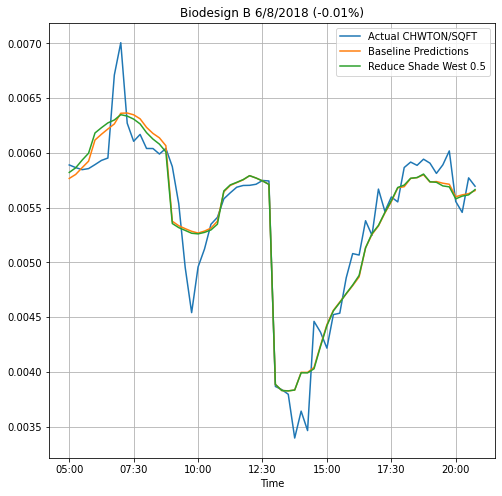

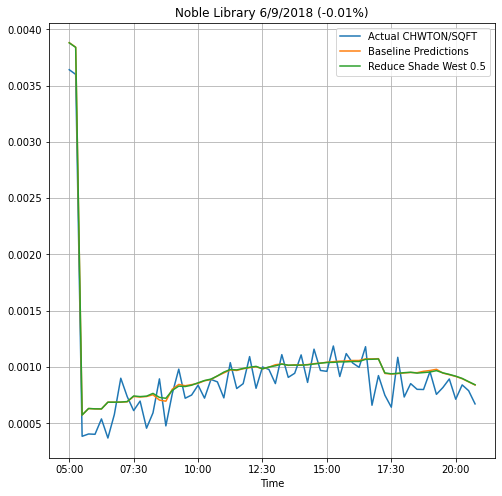

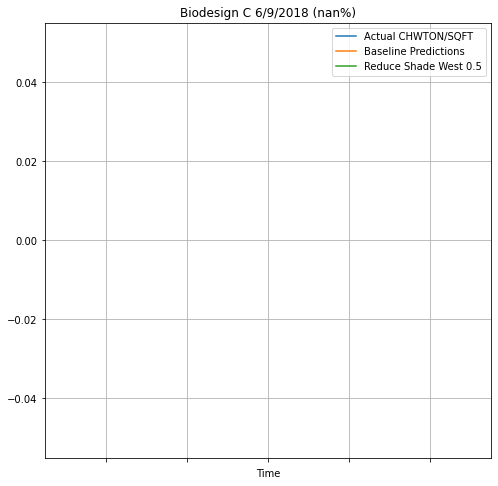

In [ ]:
# Empty list to store results
data = []

# Get unique months in dataset and unique buildings
unique_m = Data['Month'].unique()
Buildings = Data['bldgname'].unique()

# Loop Over Every Scenario
for s,S in enumerate(scen_output):
  # Loop Over Every Month
  for m,M in enumerate(unique_m):
    # Get current month data            
    month = S.loc[S['Month'] == M]
    # Check unique days in current month
    unique_d = Data[Data['Month'] == M]['Day'].unique()
    # Loop Over Every Day
    for d,D in enumerate(unique_d):
      # Get current day data
      day = month.loc[month['Day'] == D]
      # Assign for each new day
      avg = []
      # Check month and assign fname
      if str(M) == '5': fname = 'May 2018/'
      elif str(M) == '6': fname = 'June 2018/'
      elif str(M) == '7': fname = 'July 2018/'
      elif str(M) == '8': fname = 'August 2018/'
      # Loop Over Every Building
      for bldg in Buildings:
        bldg_ = day.loc[S['bldgname']==bldg]
        values = bldg_.sort_values(by=['Time'])  
        x1 = values['Baseline Predictions'].sum()
        x2 = values[scendic[str(s+1)]].sum()
        percent_change = 100*((x2 - x1)/x1)
        avg.append(percent_change)
        label1 = str(round(percent_change,2)) + '%'
        ax = values.plot(x='Time',y='Actual CHWTON/SQFT', figsize = (8,8))
        values.plot(x='Time',y='Baseline Predictions',figsize = (8,8),ax=ax)
        values.plot(x='Time',y=scendic[str(s+1)],figsize = (8,8),ax=ax)
        ax.set_title(bldg + ' ' + str(M) + '/' + str(D) + '/2018' + ' (' + label1 + ')')
        ax.grid(True)
        plt.savefig(floc + '/Sensitivity Analysis/' + unique_id + '/' + str(scendic[str(s+1)]) + '/' + fname + bldg + '-' + str(M) + '-' + str(D) + '-2018.png')
      avgarr = np.array(avg)
      avgarr = avgarr[~np.isnan(avgarr)]
      data.append([str(M) + '/' + str(D) + '/2018', round(np.average(avgarr), 2)])
  day_change = pd.DataFrame(data, columns=['Day', '(Average Change)'])
  data.append(['Total', day_change['(Average Change)'].mean()])
  day_change = pd.DataFrame(data, columns=['Day', '(Average Change)'])
  day_change.to_csv(floc + '/Sensitivity Analysis/' + unique_id + '/' + str(scendic[str(s+1)]) + '/' + 'Summary.csv')


# Microclimate Scenario Data

In [267]:
# Run Base Model Defining before to make sure correct X and Y data loaded
y_base_model = basemodel.predict(X)
y_base_model = yscaler.inverse_transform(y_base_model)
y_actual = yscaler.inverse_transform(Y)

y_actual_and_base = pd.DataFrame(y_actual, columns = ['Actual CHWTON/SQFT'])
y_actual_and_base['Baseline Predictions'] = y_base_model
date_time = bldgs_df[['Date_Time','Month','Day','bldgname']]
date_time['Time'] = date_time['Date_Time'].str[11:16]

y_actual_and_base = y_actual_and_base.join(date_time)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':


In [268]:
# Load Data from Google Drive Shared Drive (Microclimate-Building Energy)
Scen_Trees = pd.read_csv('/content/drive/Shareddrives/Microclimate-Building Energy/Data/microclimate_model/Scenarios/June_9.csv')

In [269]:
bldgs_list = []
bldgs_scen_df = pd.DataFrame()
for b,B in enumerate(Scen_Trees['bldgname'].unique()):
  X_Trees_Scaled = Scen_Trees[Scen_Trees['bldgname'] == B][0:30]
  X_Trees_Scaled[scols] = xscaler.transform(X_Trees_Scaled[scols])
  bldgs_list.append(X_Trees_Scaled)
bldgs_scen_df = bldgs_list[0]
for z in range(len(bldgs_list)-1):
  bldgs_scen_df = bldgs_scen_df.append(bldgs_list[z+1])
bldgs_scen_df.reset_index(inplace=True)
bldgs_scen_df = bldgs_scen_df.drop(columns = ['index', 'Unnamed: 0'])

In [285]:
X_Trees_Scaled = bldgs_scen_df[cols].copy()
X_Trees_Scaled = pd.get_dummies(X_Trees_Scaled)
X_Trees_Scaled = X_Trees_Scaled
X_Trees_Scaled['bldgname_Biodesign C'] = 0
bldg_cols = ['bldgname_Biodesign A', 'bldgname_Biodesign B', 'bldgname_Biodesign C',
              'bldgname_Bulldog Hall', 'bldgname_Goldwater', 'bldgname_ISTB 2',
              'bldgname_ISTB 4', 'bldgname_Noble Library', 'bldgname_Psychology',
              'bldgname_Psychology North', 'bldgname_Schwada COB']
X_Trees_Scaled = X_Trees_Scaled[bldg_cols + scols]
X_Trees_Scaled

,bldgname_Biodesign A,bldgname_Biodesign B,bldgname_Biodesign C,bldgname_Bulldog Hall,bldgname_Goldwater,bldgname_ISTB 2,bldgname_ISTB 4,bldgname_Noble Library,bldgname_Psychology,bldgname_Psychology North,bldgname_Schwada COB,Hour,Air Temp,Abs Hum,Shade North,Shade East,Shade West,Shade South
0,0,0,0,0,0,0,0,1,0,0,0,-1.595383,-1.100198,-0.814991,0.637653,0.737533,0.709824,0.868460
1,0,0,0,0,0,0,0,1,0,0,0,-1.595383,-1.194504,-0.480190,0.637653,0.737533,0.709824,0.868460
2,0,0,0,0,0,0,0,1,0,0,0,-1.595383,-1.251861,-0.459937,0.637653,0.737533,0.709824,0.868460
3,0,0,0,0,0,0,0,1,0,0,0,-1.595383,-1.291046,-0.449668,0.398819,0.711373,0.709824,0.868460
4,0,0,0,0,0,0,0,1,0,0,0,-1.378795,-1.332865,-0.360395,0.231870,0.631062,0.709824,0.868460
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,0,1,0,0,0,0,0,0,0,0,0,-0.295856,0.581417,-0.718717,0.637653,-0.766390,0.709824,-0.574173
296,0,1,0,0,0,0,0,0,0,0,0,-0.295856,0.637520,-0.761518,0.637653,-0.835425,0.709824,-0.601631
297,0,1,0,0,0,0,0,0,0,0,0,-0.295856,0.704008,-0.800907,0.637653,-0.883560,0.709824,-0.636838
298,0,1,0,0,0,0,0,0,0,0,0,-0.079268,0.757122,-0.842834,0.637653,-1.016160,0.709824,-0.762309


In [286]:
# Scale Original Data Based on Selected Features
y_trees_scen = basemodel.predict(X_Trees_Scaled)
y_trees_scen = yscaler.inverse_transform(y_trees_scen)
y_trees_scen = pd.DataFrame(y_trees_scen, columns = ['Trees Scenario'])
date_time = bldgs_scen_df[['Date_Time','Month','Day','bldgname']]
date_time['Time'] = date_time['Date_Time'].str[11:16]
y_trees_scen = y_trees_scen.join(date_time)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


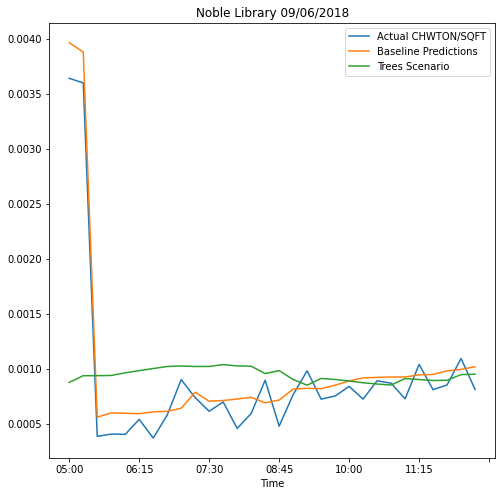

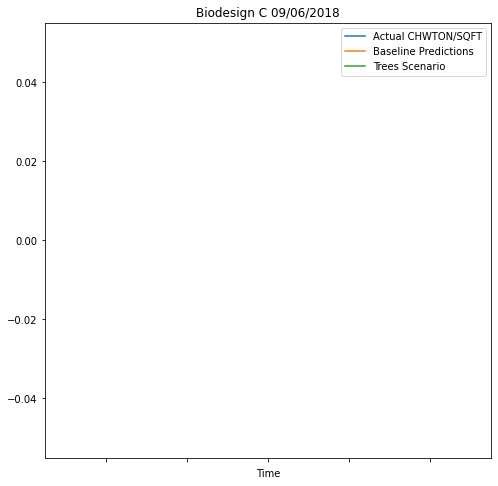

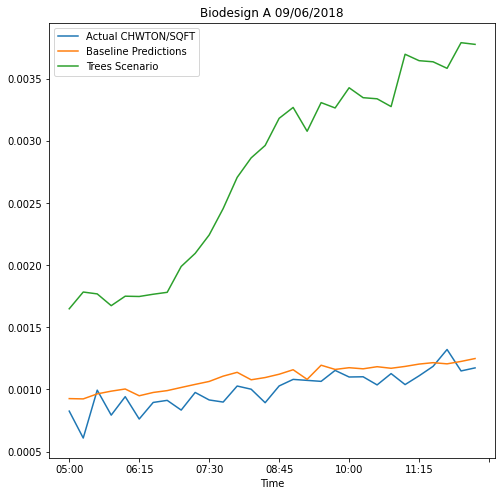

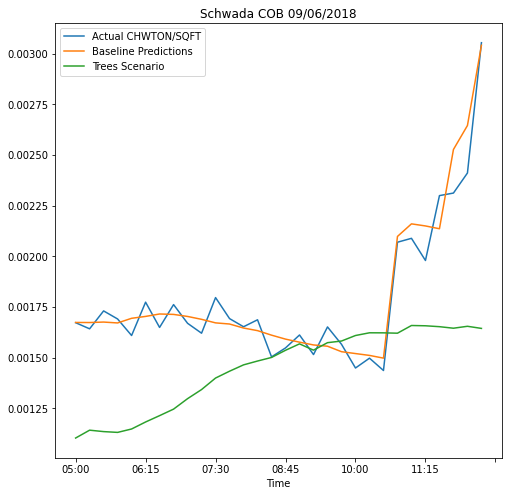

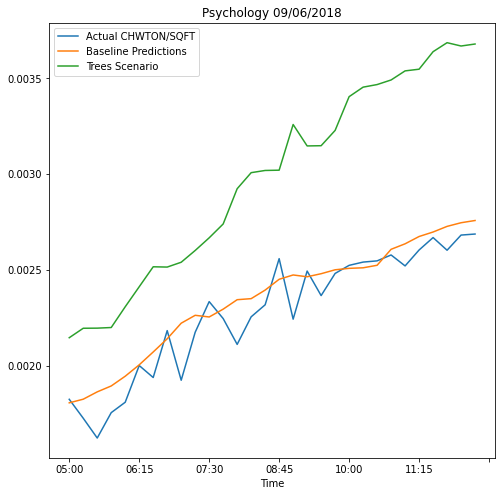

...

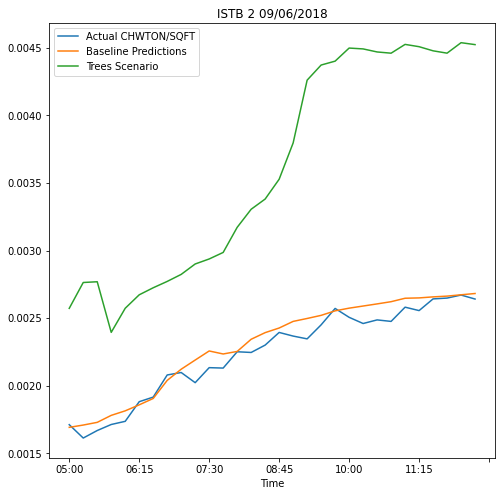

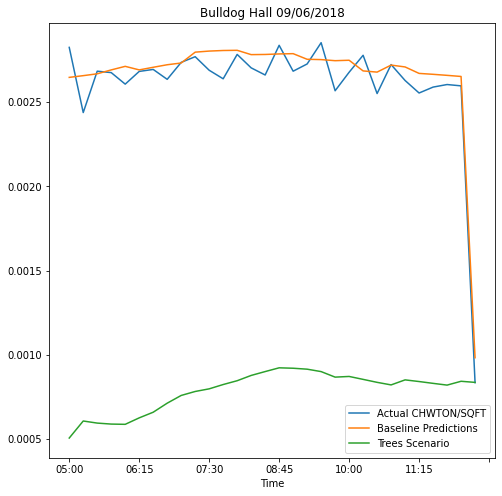

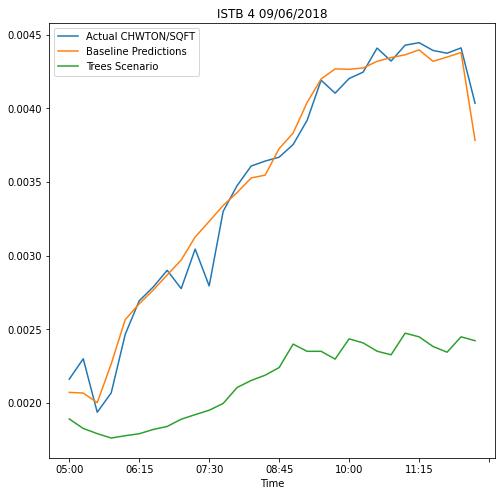

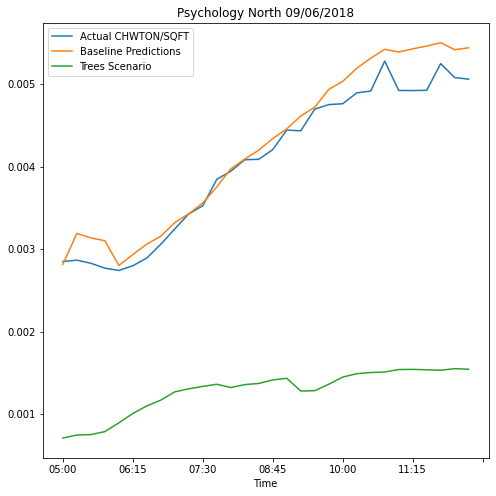

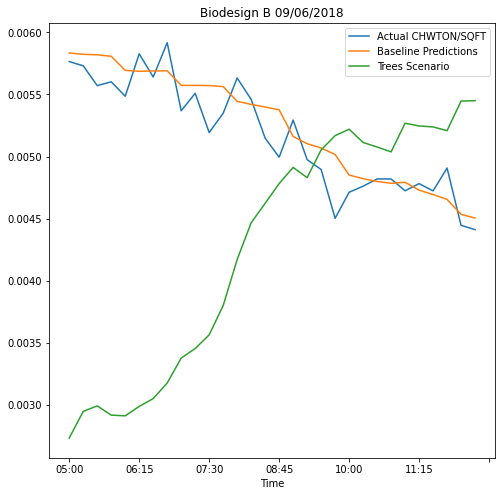

In [346]:
for b in y_actual_and_base['bldgname'].unique():
  results = y_actual_and_base[(y_actual_and_base['Month'] == 6) & (y_actual_and_base['Day'] == 9)]
  res_scen = y_trees_scen[y_trees_scen['bldgname'] == b][0:30]
  results = results[results['bldgname'] == b]
  results.reset_index(inplace=True)
  results = results[0:30]
  results['Trees Scenario'] = res_scen['Trees Scenario'].values
  ax = results.plot(x='Time',y='Actual CHWTON/SQFT', figsize = (8,8))
  results.plot(x='Time',y='Baseline Predictions',figsize = (8,8),ax=ax)
  results.plot(x='Time',y='Trees Scenario',figsize = (8,8),ax=ax)
  ax.set_title(b + ' 09/06/2018' )
  plt.savefig('/content/drive/Shareddrives/Microclimate-Building Energy/Plots/' + b + ' 09-06-2018.png')